<h1>Défi : mesurer le taux de désabonnement</h1>

Définition : Qu’est-ce que le désabonnement?
<p>Dans le cadre de ce tuto , nous considérons le désabonnement tout simplement comme étant un client qui annule son contrat de service.

Pourquoi est-il si important de s’intéresser au désabonnement?

La première étape consiste à définir la problématique  ainsi que les résultats souhaités.
<p>Ce n’est qu’en comprenant l’objectif final que vous pourrez construire un modèle utile. 
    <p>Dans notre cas, il s’agit d’identifier les clients à risque de se désabonner.

<h2>le jeu de données</h2>
Caractéristiques et prédicteur

     
        
        
- CLIENTNUM - (Feature, dbl,continuous) Numéro de client
- Customer_Age - (Feature, int,continuous) Âge du client
- Gender - (Feature, chr, discrete) Sexe du client
- Dependent_count - (Feature, int, continuous) Nombre de personnes à charge d'un utilisateur. Autrement dit, combien de personnes dépendent de l'utilisateur de la carte de crédit pour leur soutien financier. Un nombre plus élevé indique que les dépenses peuvent être élevées.
- Education_Level - (Feature, char, discrete) Niveau d'éducation du client.
- Marital_Status - (Caractéristique, caractère, discret) Situation de famille du client.
- Income_Category - (Feature, char, discrete) Catégorie de revenu du client
(Variable démographique - Catégorie de revenu annuel du titulaire du compte (<40K$, 40K$ - 60K$, 60K$ - 80K$, 80K$ - 120K$, > 120K$, Inconnu))
- Card_Category - (Feature, char, discrete) Catégorie de carte du client ( (Blue, Silver, Gold, Platinum)) 
- Credit_Limit : Limite de crédit sur la carte de crédit
- Months_on_book : mois de présence des clients à la banque
- Total_Relationship_Count : nombre total de produits détenus par les clients (cartes, comptes, etc.)
- Months_Inactive_12_mon : mois d'inactivité des clients.
- Contacts_Count_12_mon : fréquence des contacts avec les clients au cours des 12 derniers mois.
- Total_Revolving_Bal : solde impayé de la carte.
- Avg_Open_To_Buy : possibilité d'ouvrir une nouvelle limite de crédit
- Total_Trans_Amt : total des transactions au cours des 12 derniers mois.
- Contacts_count_12_mont : Je suppose qu'il contient le nombre de fois où la banque a contacté le client et/ou vice-versa. Il ne semble pas y avoir de relation avec d'autres champs (par exemple, les clients contactés qui ont quitté la banque, les clients avec un solde renouvelable, etc). Je suppose que cela a un rapport avec les campagnes publicitaires.
- Total_Amt_Chng_Q4_Q1 : représente de combien le client a augmenté ses dépenses en comparant le 4ème trimestre par rapport au 1er.
- Total_Ct_Chng_Q4_Q1 : similaire au précédent mais en nombre de transactions.
- Avg_Utilization_Ratio:représente la part du crédit disponible que le client a dépensée.
---
    
- Attrition_Flag - (Prédicteur, discret, binaire) : Exit (le client quitte l'entreprise) ou Current (le client reste dans l'entreprise).



<h1>Importation des bibliothéques</h1>

In [1]:
import numpy as np #  algebre lineaire
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt #dataviz
import seaborn as sns  #dataviz




import plotly.express as ex
import plotly.graph_objs as go


<h1>Data Loading</h1>

In [2]:
raw_data = pd.read_csv('BankChurners.csv')

In [3]:
raw_data.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.99991
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.99994
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.99998
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.99987
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.99998


In [4]:
raw_data.columns

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1',
       'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2'],
      dtype='object')

In [5]:
raw_data.describe()

,CLIENTNUM,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
count,1.012700e+04,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000
mean,7.391776e+08,46.325960,2.346203,35.928409,3.812580,2.341167,2.455317,8631.953698,1162.814061,7469.139637,0.759941,4404.086304,64.858695,0.712222,0.274894,0.159997,0.840003
std,3.690378e+07,8.016814,1.298908,7.986416,1.554408,1.010622,1.106225,9088.776650,814.987335,9090.685324,0.219207,3397.129254,23.472570,0.238086,0.275691,0.365301,0.365301
min,7.080821e+08,26.000000,0.000000,13.000000,1.000000,0.000000,0.000000,1438.300000,0.000000,3.000000,0.000000,510.000000,10.000000,0.000000,0.000000,0.000008,0.000420
25%,7.130368e+08,41.000000,1.000000,31.000000,3.000000,2.000000,2.000000,2555.000000,359.000000,1324.500000,0.631000,2155.500000,45.000000,0.582000,0.023000,0.000099,0.999660
50%,7.179264e+08,46.000000,2.000000,36.000000,4.000000,2.000000,2.000000,4549.000000,1276.000000,3474.000000,0.736000,3899.000000,67.000000,0.702000,0.176000,0.000181,0.999820
75%,7.731435e+08,52.000000,3.000000,40.000000,5.000000,3.000000,3.000000,11067.500000,1784.000000,9859.000000,0.859000,4741.000000,81.000000,0.818000,0.503000,0.000337,0.999900
max,8.283431e+08,73.000000,5.000000,56.000000,6.000000,6.000000,6.000000,34516.000000,2517.000000,34516.000000,3.397000,18484.000000,139.000000,3.714000,0.999000,0.999580,0.999990


In [6]:
raw_data.isna().sum()

CLIENTNUM                                                                                                                             0
Attrition_Flag                                                                                                                        0
Customer_Age                                                                                                                          0
Gender                                                                                                                                0
Dependent_count                                                                                                                       0
Education_Level                                                                                                                       0
Marital_Status                                                                                                                        0
Income_Category                                 

<h3>Target variable

In [7]:
raw_data['Attrition_Flag'].describe()

count                 10127
unique                    2
top       Existing Customer
freq                   8500
Name: Attrition_Flag, dtype: object

supprimer les attributs no utiltes

In [8]:
data=raw_data[raw_data.columns[:-2]]
data.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


<h1>EDA

<h3>Categorical Features</h3>


- Attrition_Flag (1: Existing Customer, 0: Attrited Customer): The Customer leave or not
- Gender (1: Male, 0: Female)
- Education_Level (Graduate , High School, Unknown, Uneducated, College, Post-Graduate, Doctorate)
- Marital_Status (Married, Single, Unknown, Divorced)
- Income_Category (Less than 40K, 40K - 60K, 80K - 120K, 60K - 80K, Unknown, 120K +) in dollar
- Card_Category (Blue, Silver, Gold, Platinum)

In [9]:
categoricals = ['Attrition_Flag', 'Gender', 'Education_Level', 'Marital_Status', 'Income_Category', 'Card_Category']

def pltCountplot(cats):
    
    fig, axis = plt.subplots(len(cats) // 3,3, figsize=(20,12))  

    index = 0
    for i in range(len(cats) // 3):
        for j in range(3):
            
            ax = sns.countplot(x=cats[index], data=data, ax=axis[i][j])
            
            if cats[index] in ['Education_Level', 'Income_Category']:
                for item in ax.get_xticklabels():
                    item.set_rotation(15)
                
            for p in ax.patches:
                height = p.get_height()
                ax.text(p.get_x()+p.get_width()/2.,
                        height + 3,
                        '{:1.2f}%'.format(height/len(data)*100),
                        ha="center") 
            index += 1

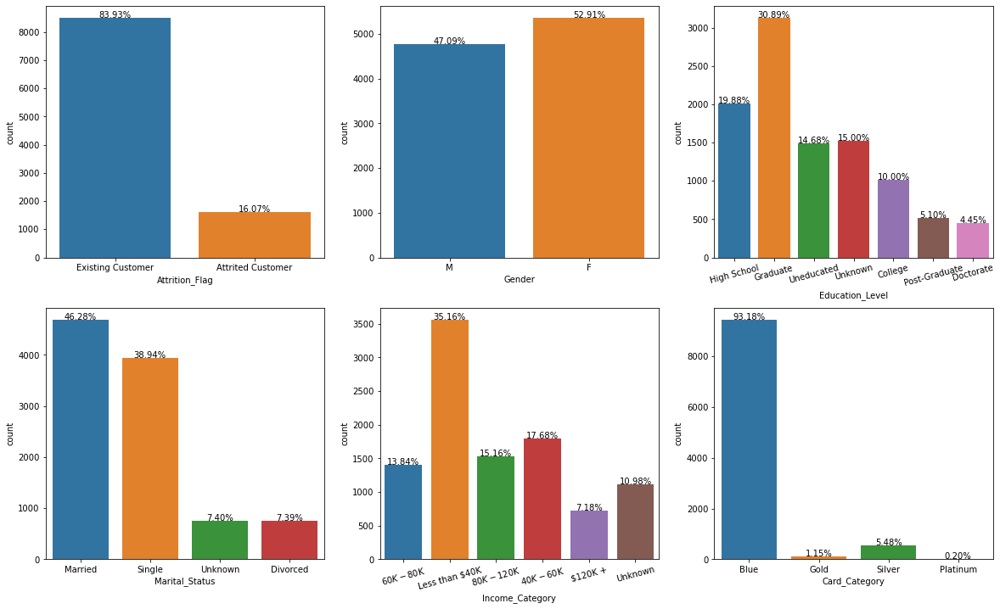

In [10]:
pltCountplot(categoricals)

Observations
- Nous pouvons voir que l'ensemble de données n'est pas distribué de manière égale selon l'Attrition_Flag. Nous avons des échantillons qui sont principalement Existants.
- Nous pouvons dire que si le niveau d'éducation s'améliore, l'utilisation de la carte de crédit diminue.
- Généralement les gens utilisent la carte bleue, cela doit être corrélé avec le revenu.

<h3>Attrition% Attributes

In [11]:
def pltCountplotHueTarget(cats, target):
    
    fig, axis = plt.subplots(len(cats) // 3,3, figsize=(20,12))  

    index = 0
    for i in range(len(cats) // 3):
        for j in range(3):
            
            ax = sns.countplot(x=cats[index], data=data, hue=target, ax=axis[i][j])
            
            ax.legend(title='Customer exit?',
                      loc='upper right',
                      labels=['Yes', 'No'])
            
            if cats[index] in ['Education_Level', 'Income_Category']:
                for item in ax.get_xticklabels():
                    item.set_rotation(15)
                
            for p in ax.patches:
                height = p.get_height()
                ax.text(p.get_x()+p.get_width()/2.,
                        height + 3,
                        '{:1.2f}%'.format(height/len(data)*100),
                        ha="center") 
            index += 1

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


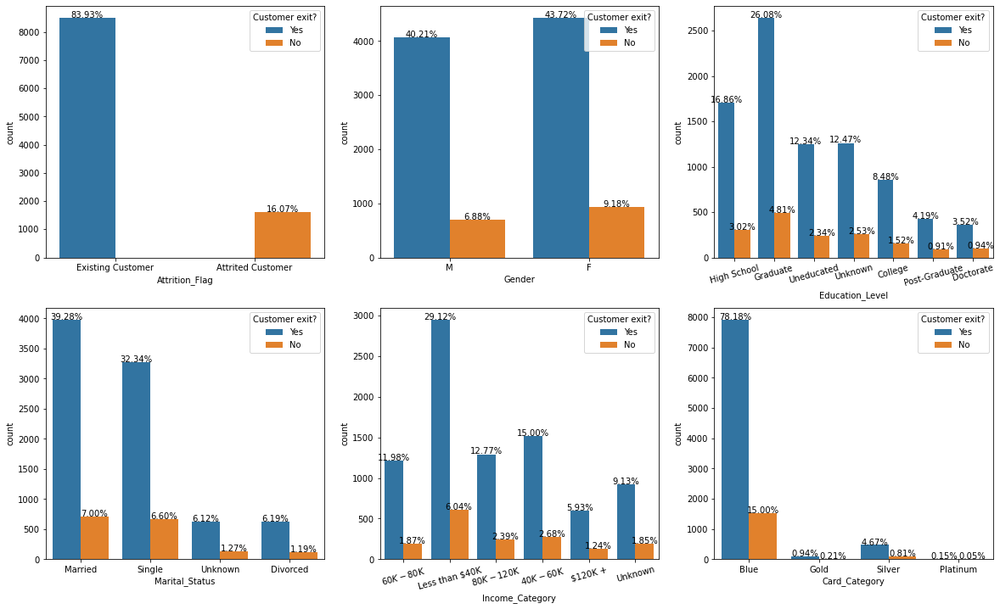

In [12]:
pltCountplotHueTarget(categoricals, 'Attrition_Flag')

Nous pouvons voir des informations sur les clients à partir des colonnes catégorielles.

- Sur la base du sexe, nous avons une répartition presque égale entre les hommes et les femmes.
- En ce qui concerne le niveau d'éducation, nous pouvons également constater que de nombreux clients sont titulaires d'un diplôme universitaire.
- L'état civil est également très bien réparti entre célibataires et mariés.
- Autre fait intéressant, nous avons de nombreux clients dont le salaire est inférieur à 40 000 euros.
- Nous avons quatre catégories de produits, mais la majorité des clients ont souscrit à Blue.
- Le nombre réel de clients qui sont partis est de 1 627 sur 8 500 clients existants (16% d'attrition).

                                                                                      
                                                                                      
Nous allons examiner de plus près les profils des anciens clients par rapport aux clients existants pour voir si les compositions sont différentes.

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value 

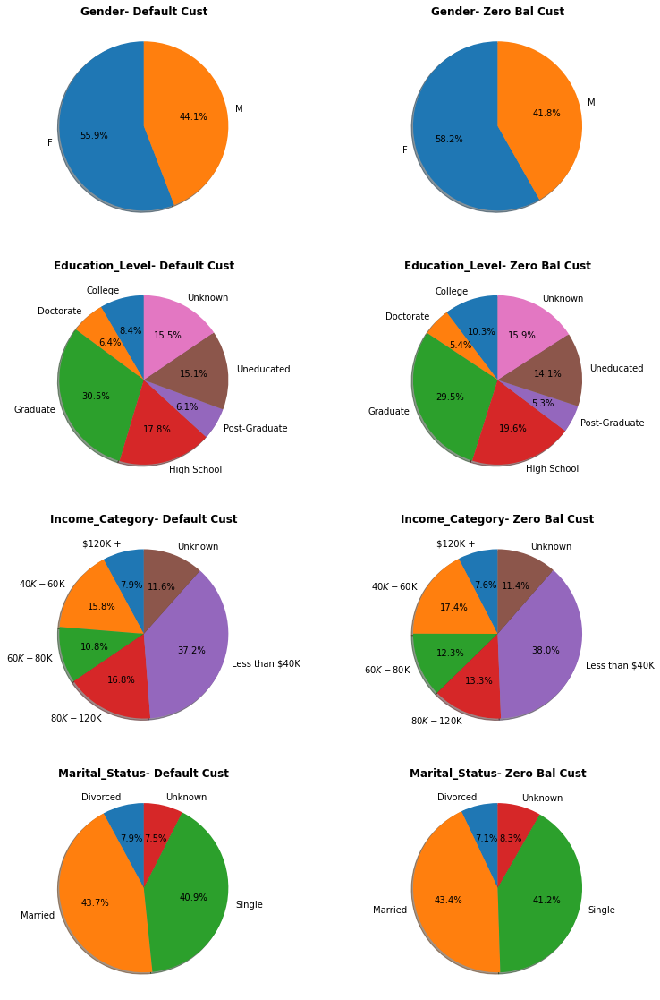

In [13]:
#prenons les client Attrited
att_cust = data[data['Attrition_Flag']=='Attrited Customer']
#selon par exemple Total_Revolving_Bal : solde impayé de la carte.
att_cust.loc[att_cust.Total_Revolving_Bal==0,'Status'] = 'solde null'
att_cust.loc[att_cust.Total_Revolving_Bal!=0,'Status'] = 'Default'



default = att_cust[att_cust['Status']=='Default']
zerobal = att_cust[att_cust['Status']!='Default']
columns = ['Gender','Education_Level','Income_Category','Marital_Status']


fiq, ax = plt.subplots(4, 2, figsize=(13,20))

for i,d in enumerate(columns):
       
        #### create pctg table 1 and plot to col 1####
        a = default[[d,'Customer_Age']].groupby(d,as_index=False).count()
        total = default[d].count()
        a['Total'] = total
        a['Pctg'] = a['Customer_Age']/a['Total']
        sizes = a['Pctg']
        labels = a[d]
        ax[i,0].pie(sizes, labels=labels, autopct='%1.1f%%', shadow=True, startangle=90)
        ax[i,0].set_title(d + '- Default Cust',fontweight="bold")
        
        
for i,d in enumerate(columns):
       
        #### create pctg table 2 and plot to col 2####
        a = zerobal[[d,'Customer_Age']].groupby(d,as_index=False).count()
        total = zerobal[d].count()
        a['Total'] = total
        a['Pctg'] = a['Customer_Age']/a['Total']
        sizes = a['Pctg']
        labels = a[d]
        ax[i,1].pie(sizes, labels=labels, autopct='%1.1f%%', shadow=True, startangle=90)  
        ax[i,1].set_title(d + '- Zero Bal Cust', fontweight="bold")

<h2>Remarques</h2>
Sur la base des observations ci-dessus, il y a quelques résultats intéressants pour les clients qui ont changé d'avis.

- La composition masculine est plus élevée de ~2% pour les clients dont le solde renouvelable est nul.
- Quelques pourcentages d'augmentation chez les diplômés, les postgradués et les docteurs.
- Les clients avec un salaire de 80k-120k augmentent de ~3%.

<h3>Caractéristiques numériques</h3>

- Customer_Age : Âge du client en années
- Dependent_count : Nombre de personnes à charge
- Months_on_book : Période de relation avec la banque
- Total_Relationship_Count : Nombre total de produits détenus par le client
- Months_Inactive_12_mon : Nombre de mois d'inactivité au cours des 12 derniers mois.
- Contacts_Count_12_mon : Nombre de contacts au cours des 12 derniers mois.
- Credit_Limit : Limite de crédit sur la carte de crédit
- Total_Revolving_Bal : Solde total renouvelable de la carte de crédit
- Avg_Open_To_Buy : Ligne de crédit ouverte à l'achat (moyenne des 12 derniers mois)
- Total_Amt_Chng_Q4_Q1 : Variation du montant des transactions (T4 sur T1)
- Total_Trans_Amt : Montant total des transactions (12 derniers mois)
- Total_Trans_Ct : Nombre total de transactions (12 derniers mois)
- Total_Ct_Chng_Q4_Q1 : Variation du nombre de transactions (T4 sur T1)
- Avg_Utilization_Ratio : Ratio moyen d'utilisation des cartes

In [14]:
numeric_columns = ['Customer_Age','Credit_Limit','Months_on_book','Avg_Utilization_Ratio','Avg_Open_To_Buy','Total_Trans_Amt','Dependent_count',
                  'Total_Relationship_Count','Months_Inactive_12_mon','Contacts_Count_12_mon','Total_Revolving_Bal',
                  'Total_Amt_Chng_Q4_Q1','Total_Trans_Ct','Total_Ct_Chng_Q4_Q1']

some_columns = ['Customer_Age', 'Credit_Limit' ,'Total_Revolving_Bal'
           ,'Total_Trans_Amt','Avg_Utilization_Ratio','Months_Inactive_12_mon']

#sns.histplot(a, color="red", label="100% Equities", kde=True, stat="density", linewidth=0)

def plotDistPlot(columns):
    fig, ax = plt.subplots(len(columns)//3, 3,figsize=(20, 12))
    
    index = 0
    for i in range(2):
        for j in range(3):
            sns.histplot(data.loc[:, columns[index]],
                         stat="density",
                         kde=True,
                         ax=ax[i][j])
            ax[i][j].set_title(columns[index])
            ax[i][j].legend(labels=['Normal', 'Actual'])
            index += 1

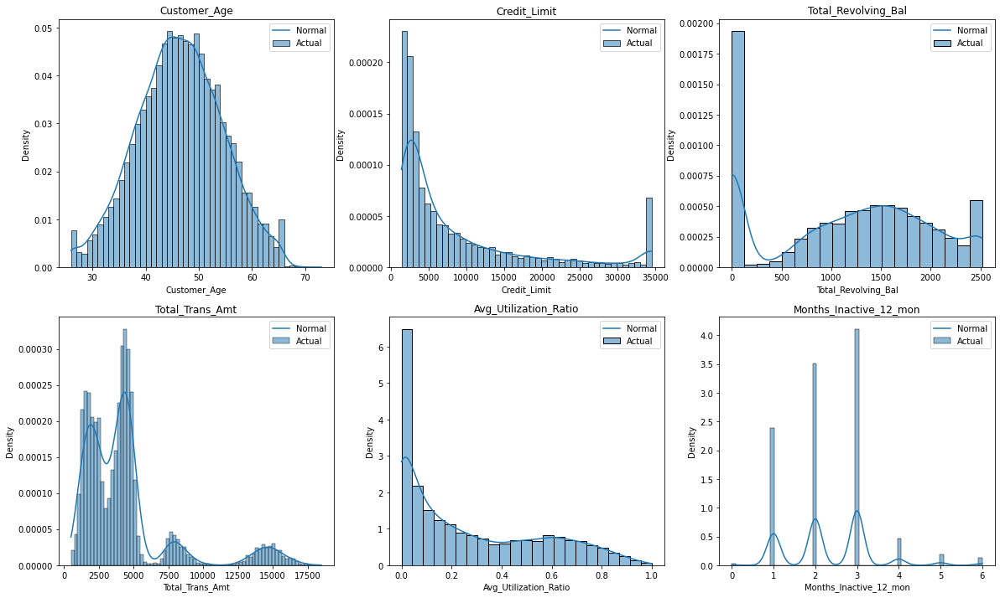

In [15]:
plotDistPlot(some_columns)

Une autre façon

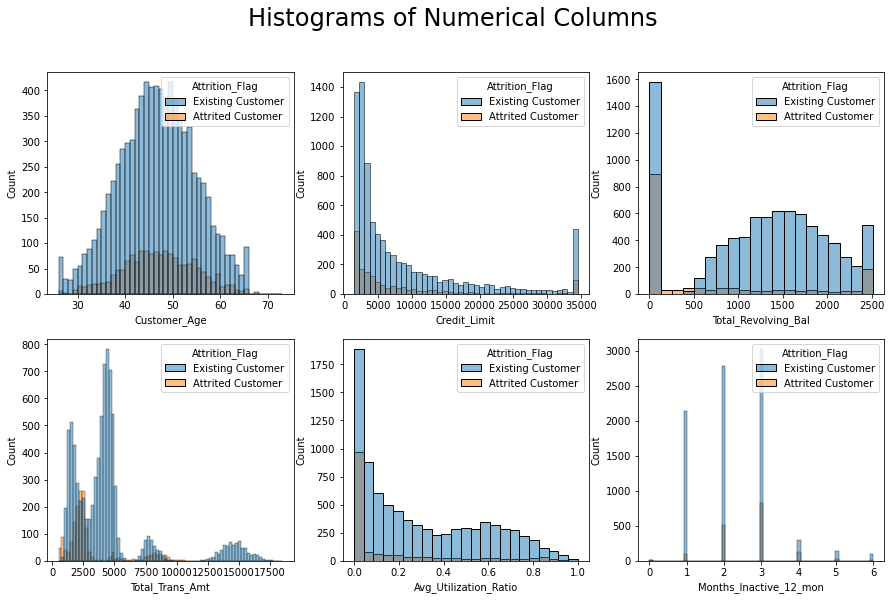

In [16]:
norow = int(round(len(some_columns)/3,0))


fiq, ax = plt.subplots(norow, 3, figsize=(15,9))


plt.suptitle('Histograms of Numerical Columns\n',horizontalalignment="center",fontstyle = "normal", fontsize = 24, fontfamily = "sans-serif")

for i,d in enumerate(some_columns):
     #print (i,d)
     if i < 3:
         chart = sns.histplot(x=data.loc[:,d], data=data, ax=ax[0,i], hue='Attrition_Flag')
     else:
         chart = sns.histplot(x=data.loc[:,d], data=data, ax=ax[1,i-6], hue='Attrition_Flag')   
        
plt.show()

<h1>Interpretations

Une exploration plus poussée des colonnes numériques permet de mieux comprendre les relations entre l'indicateur d'attrition et d'autres caractéristiques.

- L'âge du client ne montre aucun comportement spécifique, les deux histogrammes étant conformes en termes de distribution.
- La limite de crédit, cependant, montre que l'attrition a tendance à se produire chez les clients dont la limite de crédit est inférieure à 10 000.
- Les clients avec un solde renouvelable nul ont également un taux d'attrition élevé, de même que les clients avec un solde renouvelable de 2 500.
- Il n'y a pas d'attrition pour les clients dont le montant total des transactions est supérieur à 12 500.
- L'attrition est élevée pour les clients dont le ratio d'utilisation est nul.
- L'attrition est également élevée lorsque les clients sont inactifs depuis deux ou trois mois.

Les observations ci-dessus permettent de dégager des tendances intéressantes et de formuler des hypothèses sur les raisons pour lesquelles un plus grand nombre de clients quittent la banque. Ces clients semblent n'avoir pas utilisé leurs cartes pendant plus de deux mois et ils représentent un ratio d'utilisation nul ainsi qu'un solde renouvelable nul.

Il y a encore d'autres questions à poser sur la base des faits que nous voyons ci-dessus, telles que :

1. Ces clients qui sont partis, depuis combien de temps sont-ils dans la banque ?
2. Combien de produits ont-ils ?
3. Avons-nous établi suffisamment de contacts avec eux pour les retenir ?
4. Répondent-ils bien à la colonne moyenne ouverte à l'achat ?
5. Y a-t-il une cohorte spécifique basée sur l'âge, la dépendance ?
6. etc...

Pour repondre a ces questions
essayons de voir et analyser et comparer le comportement/caracteristiques des clients attried et !attrited

In [17]:
# step 1 deviser le data selon Attrition_Flag
att_cust = data[data['Attrition_Flag']=='Attrited Customer']
att = att_cust[['Customer_Age','Months_on_book','Total_Relationship_Count'
         ,'Months_Inactive_12_mon','Contacts_Count_12_mon','Credit_Limit','Avg_Open_To_Buy'
        ,'Dependent_count']]
att.columns=['Customer Age','Months on Book','Number of Products','Months Inactive','Contacts 12 Mths','Credit Limit'
          ,'Avg Open to New Credit','No of Dependents']


att_reg = data[data['Attrition_Flag']!='Attrited Customer']
reg = att_reg[['Customer_Age','Months_on_book','Total_Relationship_Count'
         ,'Months_Inactive_12_mon','Contacts_Count_12_mon','Credit_Limit','Avg_Open_To_Buy'
        ,'Dependent_count']]
reg.columns=['Customer Age','Months on Book','Number of Products','Months Inactive','Contacts 12 Mths','Credit Limit'
          ,'Avg Open to New Credit','No of Dependents']

In [18]:
att_reg.columns

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio'],
      dtype='object')

In [19]:
# step 2 creation de 2  series panda on se basant sur la description de att et reg (utilisation par exemple de la moyenne)
a = att.describe()
a =a.loc['mean',['Customer Age','Months on Book','Number of Products','Months Inactive','Contacts 12 Mths','Credit Limit'
          ,'Avg Open to New Credit','No of Dependents']]


b = reg.describe()
b =b.loc['mean',['Customer Age','Months on Book','Number of Products','Months Inactive','Contacts 12 Mths','Credit Limit'
          ,'Avg Open to New Credit','No of Dependents']]
        
frame = { 'Lost-Customers': a, 'Existing-Customers': b } 
  
result = pd.DataFrame(frame) 
pd.options.display.float_format = '{:,.2f}'.format
result

,Lost-Customers,Existing-Customers
Customer Age,46.66,46.26
Months on Book,36.18,35.88
Number of Products,3.28,3.91
Months Inactive,2.69,2.27
Contacts 12 Mths,2.97,2.36
Credit Limit,"8,136.04","8,726.88"
Avg Open to New Credit,"7,463.22","7,470.27"
No of Dependents,2.40,2.34


<h1>Interpretation..discussion</h1>
Le tableau ci-dessus montre la moyenne des différentes caractéristiques entre les clients existants et les clients perdus pour nous aider à répondre à certaines des questions précédentes.

- En moyenne, les clients perdus sont dans la banque depuis environ 36 mois, ce qui correspond aux clients existants.
- En fait, nous établissons des contacts similaires avec ces clients par rapport aux clients existants.
- Ils sont également ouverts à une nouvelle limite de crédit similaire.
- Et en moyenne, ils ont aussi une dépendance similaire, donc il n'y a pas de cohorte spécifique sur l'attrition.
- Conformément à l'hypothèse précédente, nous savons que ces clients ont été inactifs pendant un certain temps avant de fermer leur carte. Autre fait intéressant de la comparaison ci-dessus, les clients existants ont également une inactivité moyenne de 2,27 mois.

Le directeur de la banque doit se méfier du fait que certains clients existants pourraient vouloir quitter la banque.

<h2>Transactions des clients perdus par rapport au solde renouvelable

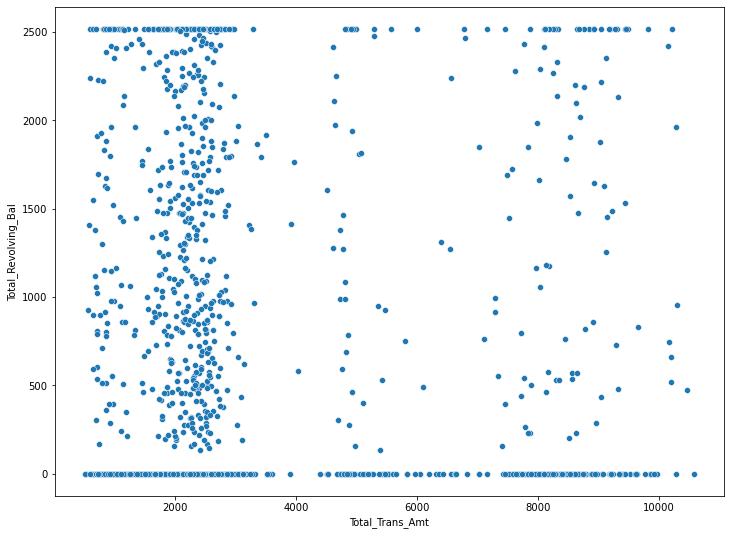

In [20]:
plt.subplots(figsize=(12,9))
sns.scatterplot(y='Total_Revolving_Bal',x='Total_Trans_Amt',data=att_cust)
plt.show()

In [21]:
pd.options.mode.chained_assignment = None

att_cust.loc[att_cust.Total_Revolving_Bal==0,'Status'] = 'Nil Balance'
att_cust.loc[att_cust.Total_Revolving_Bal!=0,'Status'] = 'Default'

Dans le tableau ci-dessus, nous pouvons voir un groupe de clients perdus, dont beaucoup ont effectué moins de 4 000 transactions et ont des soldes renouvelables sur leur compte. Cela signifie que ces clients ont fait défaut et ont quitté la banque.

Un autre regroupement entre les soldes nuls et non nuls montre que 734 de ces clients ont fait défaut dans leurs paiements tandis que les 893 clients restants sont partis sans aucun montant dû.


In [22]:
pd.DataFrame(att_cust.groupby('Status')['Total_Trans_Ct'].count().reset_index())

,Status,Total_Trans_Ct
0,Default,734
1,Nil Balance,893


Cela donne un aperçu au directeur de la banque que près de la moitié des clients attritionnés sont partis parce qu'ils ont fait défaut dans leurs paiements en retard. Une attrition plus élevée due au départ de mauvais clients n'est probablement pas une mauvaise chose.

<h2>Distribution

<h3>1. Age

Age mean :  46.32596030413745
Age median :  46.0


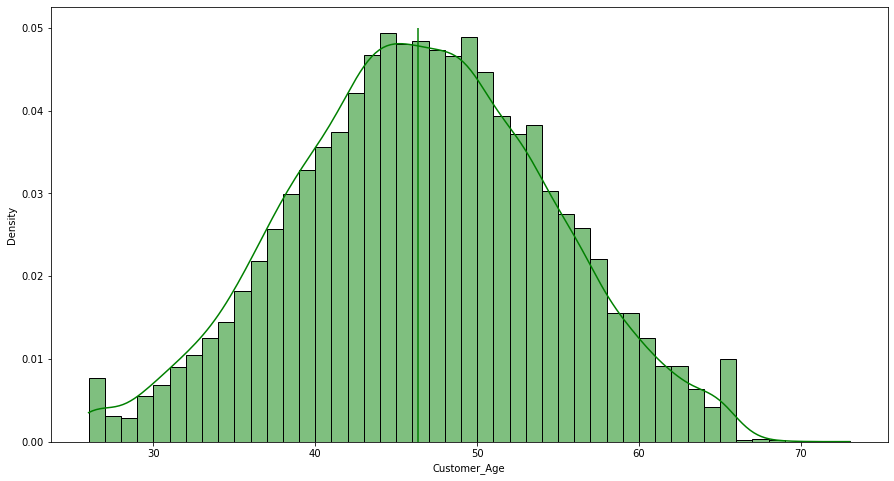

In [23]:
plt.figure(figsize=(15,8))
sns.histplot(data['Customer_Age'], color = 'green',stat="density",
                         kde=True,)
age_mean = data['Customer_Age'].mean()
plt.vlines(age_mean, 0, 0.05, color = 'green')
print('Age mean : ', age_mean)
print('Age median : ', data['Customer_Age'].median())

<h3>Interpretation</h3>
Nous pouvons voir que la distribution des âges des clients dans notre ensemble de données suit une distribution assez normale ; ainsi, l'utilisation de la caractéristique de l'âge peut se faire avec l'hypothèse de normalité.

<h3>Autre façon de faire la même chose

In [24]:
from plotly.subplots import make_subplots
fig = make_subplots(rows=2, cols=1)

tr1=go.Box(x=data['Customer_Age'],name='Age Box Plot',boxmean=True)
tr2=go.Histogram(x=data['Customer_Age'],name='Age Histogram')

fig.add_trace(tr1,row=1,col=1)
fig.add_trace(tr2,row=2,col=1)

fig.update_layout(height=700, width=1200, title_text="Distribution des Ages des clients")
fig.show()

<h4>Presentation selon la tranche d'age</h4>
<p>
pandat cut: Use cut when you need to segment and sort data values into bins

In [25]:
data['Customer_Age_Categorized'] = pd.cut(data['Customer_Age'], bins=5)
data.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Customer_Age_Categorized
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,3,"12,691.00",777,"11,914.00",1.33,1144,42,1.62,0.06,"(44.8, 54.2]"
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,2,"8,256.00",864,"7,392.00",1.54,1291,33,3.71,0.10,"(44.8, 54.2]"
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,0,"3,418.00",0,"3,418.00",2.59,1887,20,2.33,0.00,"(44.8, 54.2]"
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,1,"3,313.00",2517,796.00,1.41,1171,20,2.33,0.76,"(35.4, 44.8]"
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,0,"4,716.00",0,"4,716.00",2.17,816,28,2.50,0.00,"(35.4, 44.8]"


In [26]:
data.groupby('Card_Category')['Customer_Age_Categorized'].value_counts()

Card_Category  Customer_Age_Categorized
Blue           (44.8, 54.2]                4028
               (35.4, 44.8]                3015
               (54.2, 63.6]                1385
               (25.953, 35.4]               858
               (63.6, 73.0]                 150
Gold           (44.8, 54.2]                  56
               (35.4, 44.8]                  41
               (25.953, 35.4]                10
               (54.2, 63.6]                   9
Platinum       (44.8, 54.2]                  13
               (35.4, 44.8]                   6
               (54.2, 63.6]                   1
Silver         (44.8, 54.2]                 245
               (35.4, 44.8]                 194
               (54.2, 63.6]                  61
               (25.953, 35.4]                51
               (63.6, 73.0]                   4
Name: Customer_Age_Categorized, dtype: int64

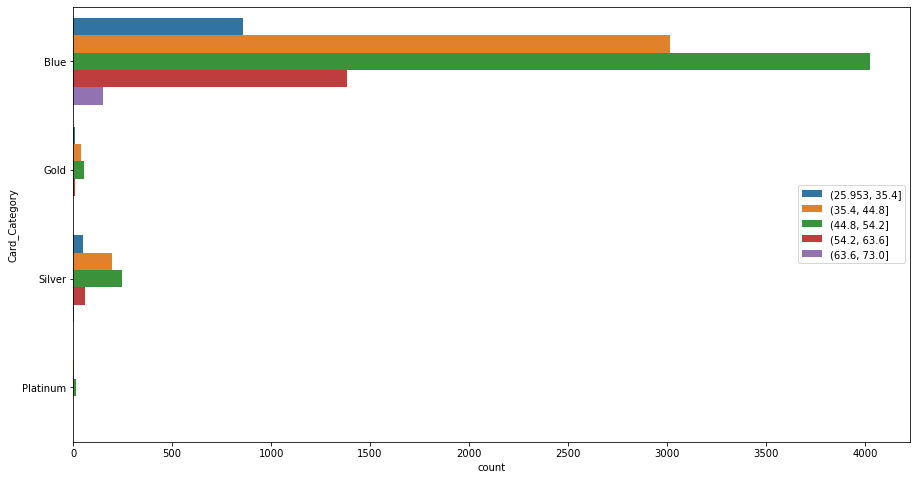

In [27]:
plt.figure(figsize=(15,8))
sns.countplot(y='Card_Category', hue='Customer_Age_Categorized', data = data)
plt.legend(loc = 'center right')

<h2>Gendere

In [28]:
data['Gender'].value_counts()

F    5358
M    4769
Name: Gender, dtype: int64

In [29]:
data.groupby('Gender')['Credit_Limit'].agg(['mean','count'])

,mean,count
Gender,,
F,"5,023.85",5358
M,"12,685.67",4769


Note : Les femmes utilisent plus de cartes de crédit mais les hommes ont une limite de crédit plus élevée que les femmes.

In [30]:
fig = make_subplots(
    rows=2, cols=2,subplot_titles=('','<b>Platinum Card Holders','<b>Blue Card Holders<b>','Residuals'),
    vertical_spacing=0.09,
    specs=[[{"type": "pie","rowspan": 2}       ,{"type": "pie"}] ,
           [None                               ,{"type": "pie"}]            ,                                      
          ]
)

fig.add_trace(
    go.Pie(values=data.Gender.value_counts().values,labels=['<b>Female<b>','<b>Male<b>'],hole=0.3,pull=[0,0.3]),
    row=1, col=1
)

fig.add_trace(
    go.Pie(
        labels=['Female Platinum Card Holders','Male Platinum Card Holders'],
        values=data.query('Card_Category=="Platinum"').Gender.value_counts().values,
        pull=[0,0.05,0.5],
        hole=0.3
        
    ),
    row=1, col=2
)

fig.add_trace(
    go.Pie(
        labels=['Female Blue Card Holders','Male Blue Card Holders'],
        values=data.query('Card_Category=="Blue"').Gender.value_counts().values,
        pull=[0,0.2,0.5],
        hole=0.3
    ),
    row=2, col=2
)



fig.update_layout(
    height=800,
    showlegend=True,
    title_text="<b>Distribution Of Gender And Different Card Statuses<b>",
)

fig.show()

<h3>Interpratation</h3>
Dans notre ensemble de données, les échantillons de femmes sont plus nombreux que ceux des hommes, mais le pourcentage de différence n'est pas très significatif, ce qui nous permet de dire que les sexes sont uniformément répartis.

<h3>Autre façon de faire la même chose


<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.



<Figure size 720x720 with 0 Axes>

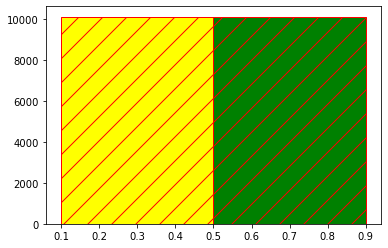

<Figure size 720x720 with 0 Axes>

In [31]:
colors = ['b','g']
x1=data['Gender']=='M'
x2=data['Gender']=='F'
plt.hist([x1, x2], bins = 1, color = ['yellow', 'green'],
            edgecolor = 'red', hatch = '/', label = ['M', 'F'],
            histtype = 'bar') # bar est le defaut

plt.figure(figsize = (10,10))


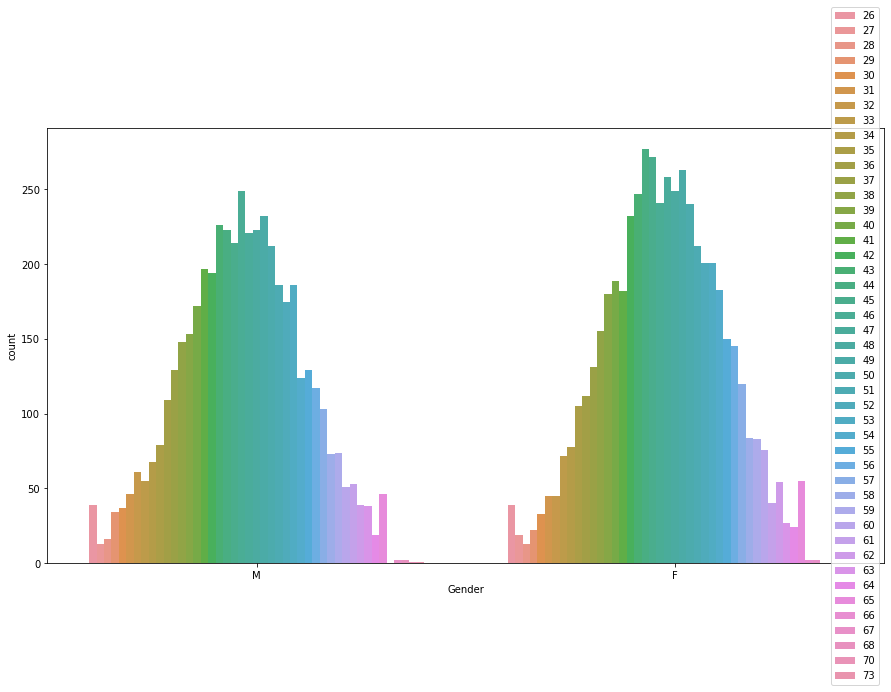

In [32]:
plt.figure(figsize=(15,8))
sns.countplot(x='Gender', hue='Customer_Age', data = data)
plt.legend(loc = 'center right')

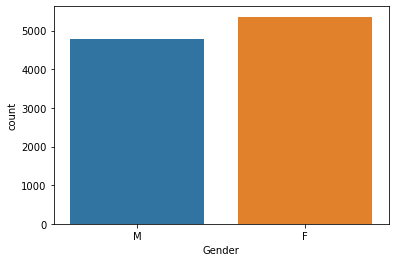

In [33]:
ax = sns.countplot(x="Gender", data=data)

<h3> Attrition % Age

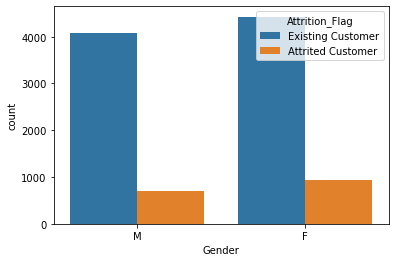

In [34]:
ax = sns.countplot(x="Gender",hue='Attrition_Flag' , data=data)

<AxesSubplot:>

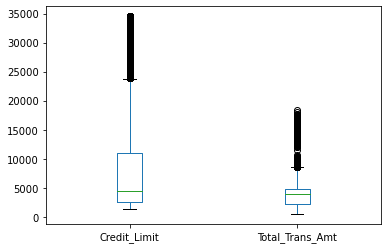

In [35]:
data[['Credit_Limit','Total_Trans_Amt']].plot.box()

{'whiskers': [<matplotlib.lines.Line2D at 0xe6a6988>,
 'caps': [<matplotlib.lines.Line2D at 0xe6c6c48>,
 'boxes': [<matplotlib.lines.Line2D at 0xe6c64c8>],
 'medians': [<matplotlib.lines.Line2D at 0xe6cba08>],
 'fliers': [<matplotlib.lines.Line2D at 0xe6bea08>],
 'means': []}

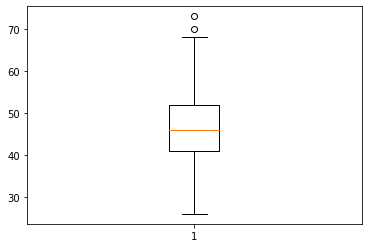

In [36]:
plt.boxplot(data['Customer_Age'])


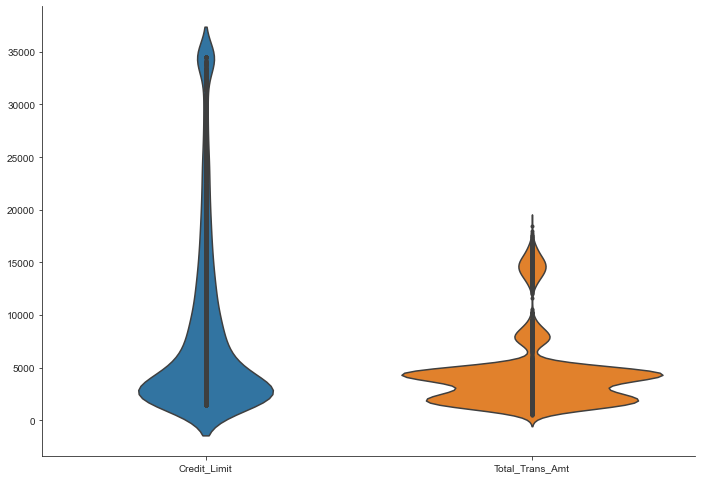

In [37]:
# plot  avec vilinplot
sns.set_style('ticks')
fig, ax = plt.subplots()
# the size of A4 paper
fig.set_size_inches(11.7, 8.27)
sns.violinplot(data=data[['Credit_Limit','Total_Trans_Amt']], inner="points", ax=ax)    
sns.despine()

<h3>3.Education_Level

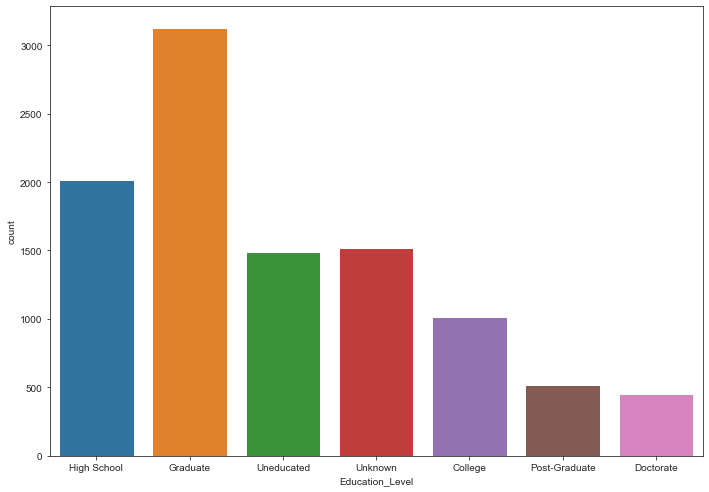

In [38]:

sns.set_style('ticks')
fig, ax = plt.subplots()
# the size of A4 paper
fig.set_size_inches(11.7, 8.27)
ax = sns.countplot(x="Education_Level" , data=data)

(-0.5, 511.5, 383.5, -0.5)

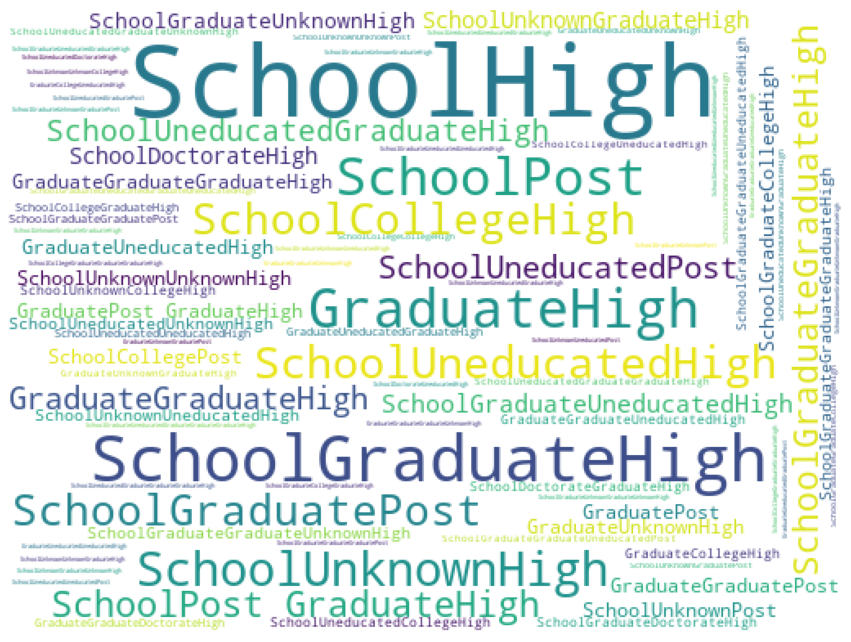

In [39]:
from wordcloud import WordCloud

plt.subplots(figsize=(15,22))
wordcloud = WordCloud(background_color = 'white',
                     width=512,
                     height=384).generate("".join(data.Education_Level))

plt.imshow(wordcloud)
plt.axis('off')

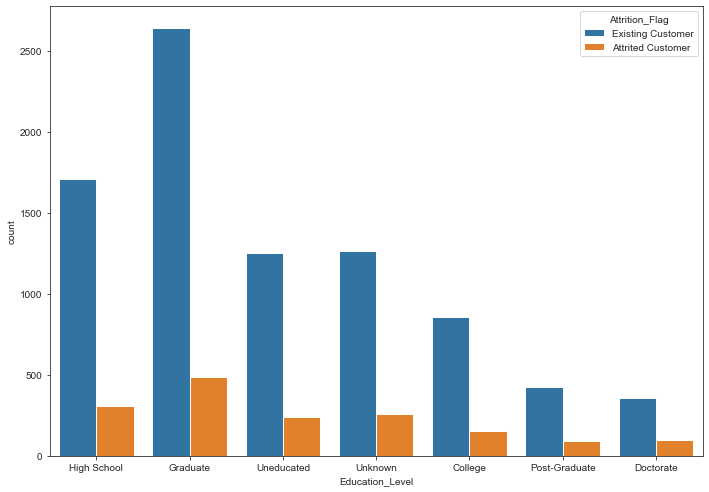

In [40]:
sns.set_style('ticks')
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
ax = sns.countplot(x="Education_Level",hue='Attrition_Flag' , data=data)

ou meme avec ex.pie

In [41]:
ex.pie(data,names='Education_Level',title='Propotion Of Education Levels',hole=0.33)

In [42]:
#possibiité de faire de croisement

import plotly.express as px
df = px.data.tips()
fig = px.sunburst(data, path=['Attrition_Flag', 'Gender', 'Card_Category'], values='Credit_Limit',title="Click Chart pour Examiner ... ")
fig.show()

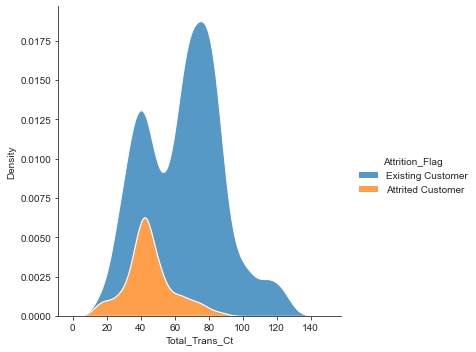

In [43]:
ax=sns.displot(data, x="Total_Trans_Ct", hue="Attrition_Flag", kind="kde", multiple="stack")

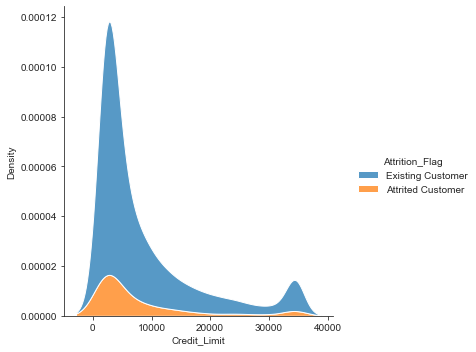

In [44]:
ax=sns.displot(data, x="Credit_Limit", hue="Attrition_Flag", kind="kde", multiple="stack")


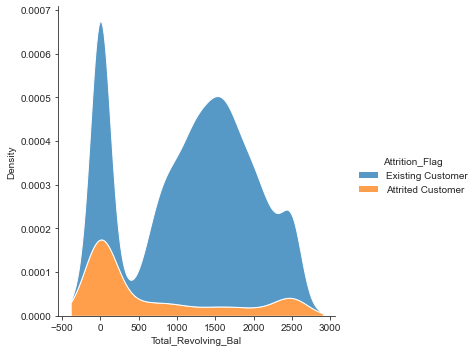

In [45]:
ax=sns.displot(data, x="Total_Revolving_Bal", hue="Attrition_Flag", kind="kde", multiple="stack")


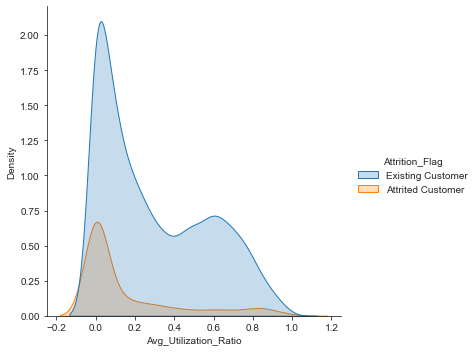

In [46]:
ax=sns.displot(data, x="Avg_Utilization_Ratio", hue="Attrition_Flag", kind="kde",fill='true')

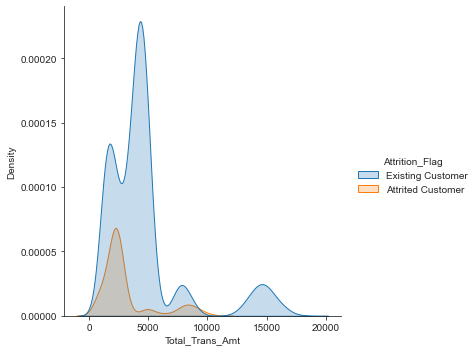

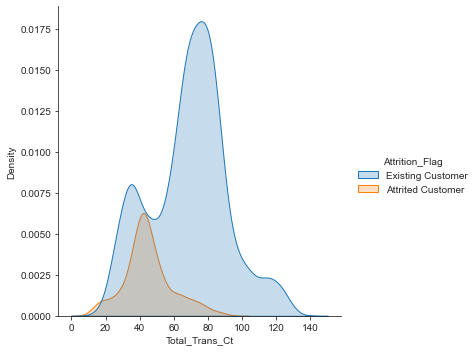

In [47]:
ax=sns.displot(data, x="Total_Trans_Amt", hue="Attrition_Flag", kind="kde",fill='true')
ax=sns.displot(data, x="Total_Trans_Ct", hue="Attrition_Flag", kind="kde",fill='true')


La classe d'attrition a un nombre total de transactions, une variation totale du nombre de transactions, un solde renouvelable total, un ratio d'utilisation moyen et un montant total de transactions <b>plus faible</b> à ceux de la classe des clients existants, comme prévu.

Bivariate distributions

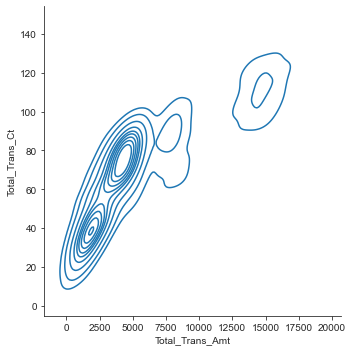

In [48]:
sns.displot(data, x="Total_Trans_Amt", y="Total_Trans_Ct", kind="kde")

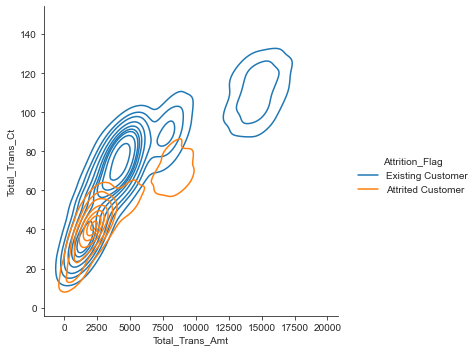

In [49]:
sns.displot(data, x="Total_Trans_Amt", y="Total_Trans_Ct", hue="Attrition_Flag", kind="kde")

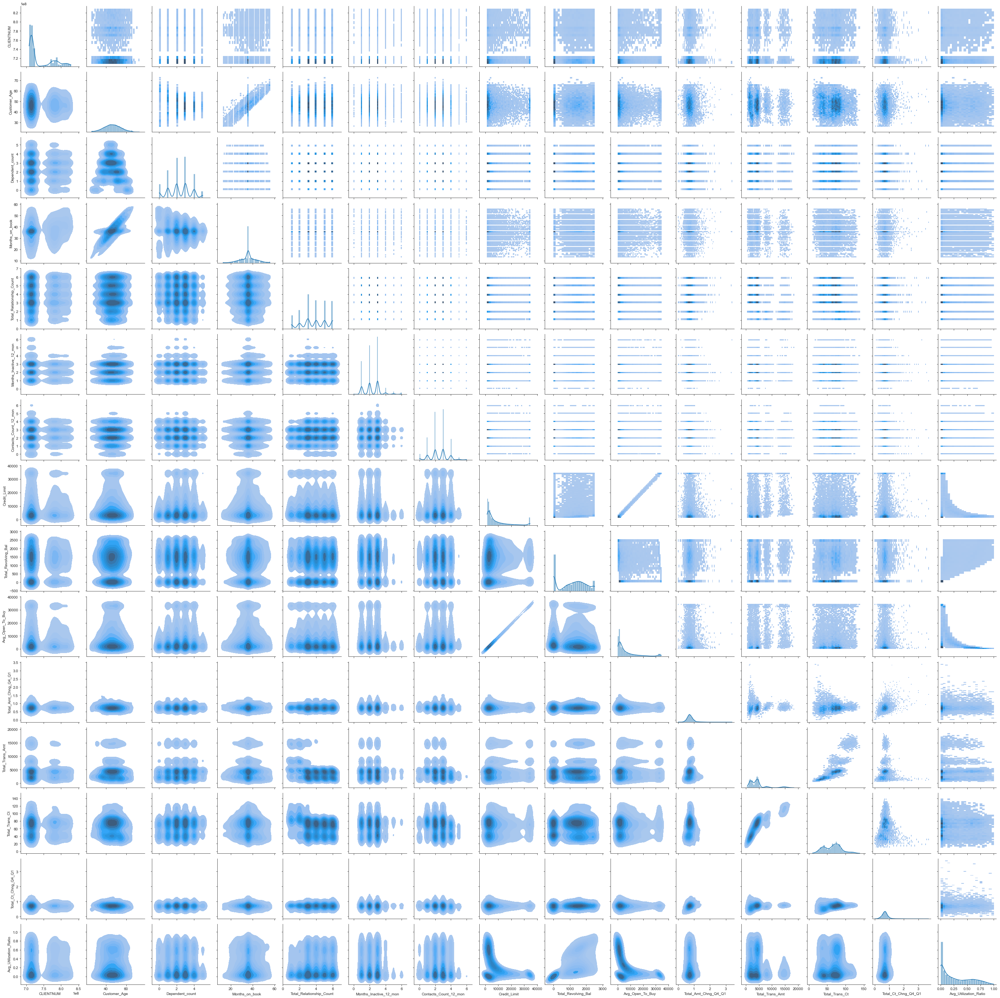

In [50]:
g = sns.PairGrid(data)
g.map_upper(sns.histplot)
g.map_lower(sns.kdeplot, fill=True)
g.map_diag(sns.histplot, kde=True)

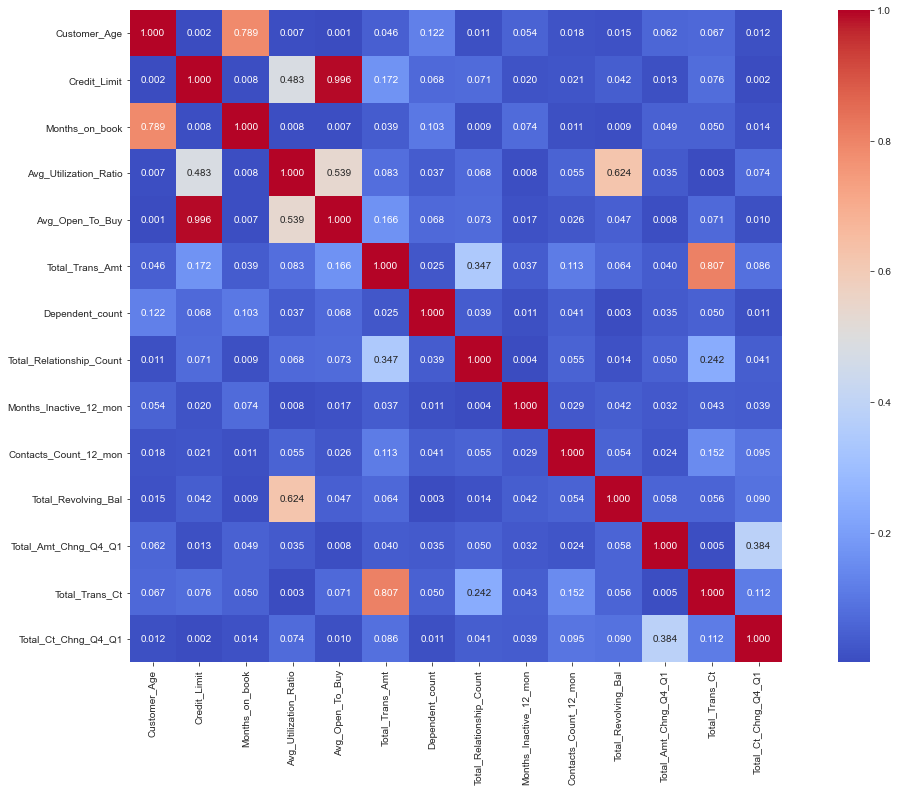

In [50]:
corr_data = data.loc[:, numeric_columns].corr()

plt.figure(figsize=(20,12))
sns.heatmap(corr_data.abs(), annot=True, fmt='.3f',cmap='coolwarm',square=True)
plt.show()

<h2>Remarque</h2>
En général, les caractéristiques n'ont pas une forte corrélation entre elles. Cela ne signifie pas qu'elles ne sont pas corrélées. Dans la matrice corr, nous pouvons voir des caractéristiques corrélées linéairement. Peut-être que nos caractéristiques sont corrélées de façon quadratique ou polynomiale à n degrés. Nous ne pouvons pas voir si les caractéristiques sont corrélées de façon polynomiale de degré n dans la matrice corr.

mais on peut observer quelques caractéristiques qui sont corrélées plus au moins


In [51]:
data2=data.iloc[:,1:6]

In [52]:
data2.head()

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level
0,Existing Customer,45,M,3,High School
1,Existing Customer,49,F,5,Graduate
2,Existing Customer,51,M,3,Graduate
3,Existing Customer,40,F,4,High School
4,Existing Customer,40,M,3,Uneducated


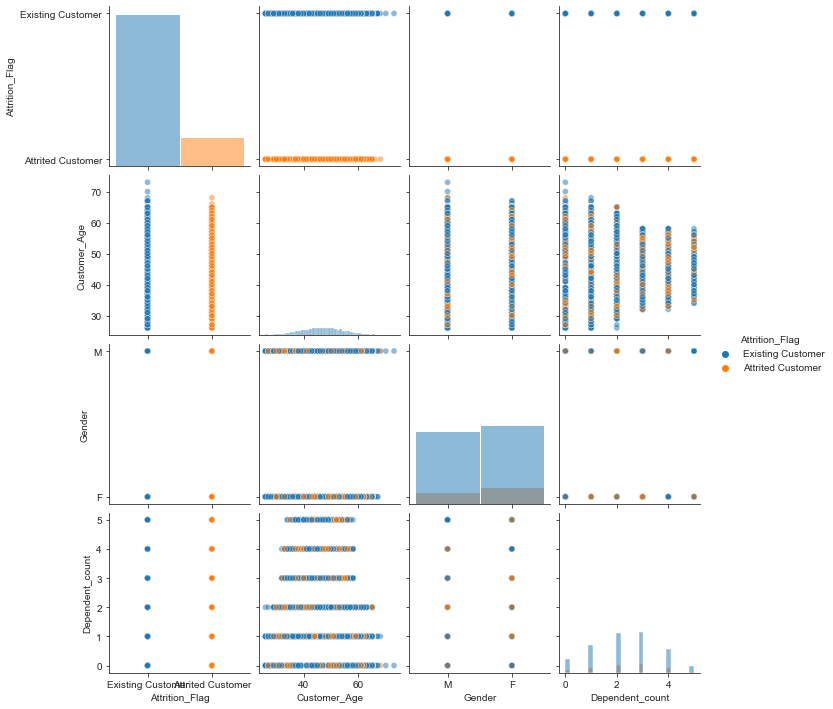

In [53]:

g= sns.pairplot(data2,hue = 'Attrition_Flag', diag_kind= 'hist',
             vars=data2.columns[:-1],
             plot_kws=dict(alpha=0.5), 
             diag_kws=dict(alpha=0.5))
plt.show()

<h1>Data Preparation & Features Enginiring</h1>

<h2>Missing values</h2>

In [54]:
data.isna().sum()

CLIENTNUM                   0
Attrition_Flag              0
Customer_Age                0
Gender                      0
Dependent_count             0
Education_Level             0
Marital_Status              0
Income_Category             0
Card_Category               0
Months_on_book              0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal         0
Avg_Open_To_Buy             0
Total_Amt_Chng_Q4_Q1        0
Total_Trans_Amt             0
Total_Trans_Ct              0
Total_Ct_Chng_Q4_Q1         0
Avg_Utilization_Ratio       0
Customer_Age_Categorized    0
dtype: int64

In [55]:
datamissing=data

In [56]:
# Suppression de certaines valeurs de la seconde variable (colonne)
#  pour obtenir des données manquantes
n_samples = datamissing.shape[0]

In [57]:
# définition du taux de lignes à valeurs manquantes
missing_rate = 0.03

n_missing_samples = int(np.floor(n_samples * missing_rate))
print("Nous allons supprimer {} valeurs".format(n_missing_samples))



Nous allons supprimer 303 valeurs


In [58]:
_df = datamissing.sample(n=n_missing_samples) 

In [59]:
_df.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Customer_Age_Categorized
1726,794562783,Existing Customer,28,F,0,Unknown,Single,Unknown,Blue,13,...,2,"21,691.00",661,"21,030.00",0.77,2534,51,0.96,0.03,"(25.953, 35.4]"
3780,716853258,Existing Customer,64,M,1,Graduate,Single,Less than $40K,Blue,45,...,2,"4,417.00",0,"4,417.00",0.90,4253,72,0.90,0.00,"(63.6, 73.0]"
300,819700533,Existing Customer,50,M,0,High School,Single,$120K +,Silver,45,...,3,"14,938.00",2303,"12,635.00",0.80,949,27,2.00,0.15,"(44.8, 54.2]"
5814,714246333,Attrited Customer,58,F,4,High School,Married,Unknown,Blue,48,...,3,"5,396.00",1803,"3,593.00",0.49,2107,39,0.39,0.33,"(54.2, 63.6]"
5531,712425258,Existing Customer,46,F,4,Unknown,Single,Less than $40K,Blue,26,...,3,"1,859.00",1379,480.00,0.84,4260,72,0.71,0.74,"(44.8, 54.2]"


In [60]:
_df['Gender'].index

Int64Index([1726, 3780,  300, 5814, 5531, 2323, 4445, 6948, 6419, 6650,
            ...
            4850, 5105, 8411, 2369, 6030, 9938, 8173, 6676, 4318, 8562],
           dtype='int64', length=303)

In [61]:
_df

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Customer_Age_Categorized
1726,794562783,Existing Customer,28,F,0,Unknown,Single,Unknown,Blue,13,...,2,"21,691.00",661,"21,030.00",0.77,2534,51,0.96,0.03,"(25.953, 35.4]"
3780,716853258,Existing Customer,64,M,1,Graduate,Single,Less than $40K,Blue,45,...,2,"4,417.00",0,"4,417.00",0.90,4253,72,0.90,0.00,"(63.6, 73.0]"
300,819700533,Existing Customer,50,M,0,High School,Single,$120K +,Silver,45,...,3,"14,938.00",2303,"12,635.00",0.80,949,27,2.00,0.15,"(44.8, 54.2]"
5814,714246333,Attrited Customer,58,F,4,High School,Married,Unknown,Blue,48,...,3,"5,396.00",1803,"3,593.00",0.49,2107,39,0.39,0.33,"(54.2, 63.6]"
5531,712425258,Existing Customer,46,F,4,Unknown,Single,Less than $40K,Blue,26,...,3,"1,859.00",1379,480.00,0.84,4260,72,0.71,0.74,"(44.8, 54.2]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9938,720539583,Existing Customer,46,M,4,Unknown,Single,$60K - $80K,Blue,31,...,4,"21,226.00",1202,"20,024.00",0.76,14103,96,0.66,0.06,"(44.8, 54.2]"
8173,747074058,Existing Customer,47,F,3,Unknown,Single,Unknown,Blue,40,...,0,"7,114.00",1637,"5,477.00",0.70,4758,81,0.50,0.23,"(44.8, 54.2]"
6676,751150233,Existing Customer,43,M,5,Graduate,Single,Less than $40K,Blue,36,...,2,"1,438.30",0,"1,438.30",0.64,4459,65,0.48,0.00,"(35.4, 44.8]"
4318,713482608,Existing Customer,47,M,4,College,Married,$40K - $60K,Blue,35,...,2,"3,560.00",751,"2,809.00",1.10,4060,79,0.97,0.21,"(44.8, 54.2]"


In [62]:

for count, item in enumerate(_df.index):
    if item % 2 == 0:
        _df['Gender'][item] = np.nan

In [63]:
_df.isnull().sum()

CLIENTNUM                     0
Attrition_Flag                0
Customer_Age                  0
Gender                      144
Dependent_count               0
Education_Level               0
Marital_Status                0
Income_Category               0
Card_Category                 0
Months_on_book                0
Total_Relationship_Count      0
Months_Inactive_12_mon        0
Contacts_Count_12_mon         0
Credit_Limit                  0
Total_Revolving_Bal           0
Avg_Open_To_Buy               0
Total_Amt_Chng_Q4_Q1          0
Total_Trans_Amt               0
Total_Trans_Ct                0
Total_Ct_Chng_Q4_Q1           0
Avg_Utilization_Ratio         0
Customer_Age_Categorized      0
dtype: int64

In [64]:
for i in _df.index:
    if i % 3 == 0 :
        _df['Card_Category'][i]=np.nan

In [65]:
_df.isnull().sum()

CLIENTNUM                     0
Attrition_Flag                0
Customer_Age                  0
Gender                      144
Dependent_count               0
Education_Level               0
Marital_Status                0
Income_Category               0
Card_Category               109
Months_on_book                0
Total_Relationship_Count      0
Months_Inactive_12_mon        0
Contacts_Count_12_mon         0
Credit_Limit                  0
Total_Revolving_Bal           0
Avg_Open_To_Buy               0
Total_Amt_Chng_Q4_Q1          0
Total_Trans_Amt               0
Total_Trans_Ct                0
Total_Ct_Chng_Q4_Q1           0
Avg_Utilization_Ratio         0
Customer_Age_Categorized      0
dtype: int64

In [66]:
for i in _df.index:
    if i % 32 == 0:
        _df['Total_Trans_Amt'][i]= np.nan

In [67]:
add = lambda x, y: x + y

In [68]:
add(4,7)

11

Visualisation

(array([20.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  1.]),
 array([  0. ,  14.4,  28.8,  43.2,  57.6,  72. ,  86.4, 100.8, 115.2,
        129.6, 144. ]),
 <BarContainer object of 10 artists>)

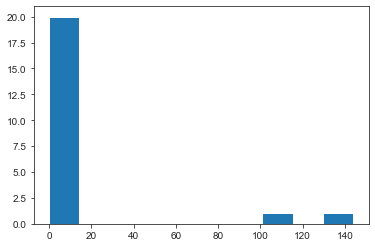

In [69]:
counts, bins = np.histogram(_df.isnull().sum())
plt.hist(bins[:-1], bins, weights=counts)

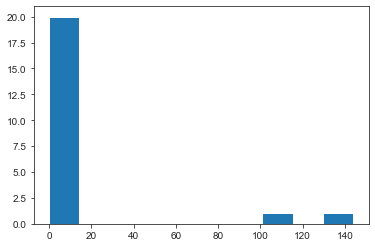

In [70]:
plt.hist(_df.isnull().sum(), bins = 10)
plt.show()

In [71]:
fig = px.bar(_df.isnull().sum(),x=_df.isnull().sum().values )
fig.show()

In [72]:
trace = go.Bar(y=_df.isnull().sum().values,
               x=_df.isnull().columns,
               name="One Way",
   marker=dict(color="#FF8000")
              )
fig = go.Figure(data=[trace])
fig.show()

<h2>Processing

pourquoi il y a manque de données ?

Comment caractériser ici le mécanisme par lequel des données manquent : MCAR, MAR, MNAR ?


Commencons par  <h3>Total_Trans_Amt

Nous pouvons commencer par réaliser une imputation par la moyenne, c’est-à-dire que lorsque la valeur de la seconde colonne est absente, nous utilisons à la place la valeur moyenne de cette colonne.

In [73]:
_df.describe()

,CLIENTNUM,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
count,303.00,303.00,303.00,303.00,303.00,303.00,303.00,303.00,303.00,303.00,303.00,293.00,303.00,303.00,303.00
mean,"738,159,785.72",46.38,2.46,35.73,3.83,2.28,2.51,"8,807.30","1,159.55","7,647.75",0.74,"4,398.64",63.67,0.70,0.27
std,"36,223,244.81",7.51,1.21,7.38,1.58,1.04,1.13,"9,295.40",800.24,"9,300.56",0.19,"3,598.50",24.13,0.22,0.28
min,"708,134,283.00",26.00,0.00,13.00,1.00,0.00,0.00,"1,438.30",0.00,28.00,0.24,689.00,13.00,0.07,0.00
25%,"713,305,158.00",41.00,2.00,32.50,3.00,1.00,2.00,"2,395.50",566.50,"1,298.00",0.63,"2,020.00",43.00,0.59,0.03
50%,"717,995,958.00",47.00,3.00,36.00,4.00,2.00,3.00,"4,439.00","1,271.00","3,593.00",0.73,"3,734.00",68.00,0.69,0.16
75%,"771,848,020.50",52.00,3.00,40.00,5.00,3.00,3.00,"11,413.00","1,743.00","10,556.00",0.84,"4,719.00",80.00,0.79,0.53
max,"827,984,658.00",65.00,5.00,56.00,6.00,6.00,5.00,"34,516.00","2,517.00","34,516.00",1.71,"16,695.00",127.00,2.00,0.98


In [74]:
_df_mean=_df.copy(deep=True)

In [75]:
# imputation par la moyenne: les NaN sont remplacés par la moyenne
from sklearn.impute import SimpleImputer
imp = SimpleImputer(missing_values=np.nan, strategy='mean')
#Simple imputer expects a column vector, so converting the pandas Series
_df_mean['Total_Trans_Amt'] = imp.fit_transform(_df_mean['Total_Trans_Amt'].to_numpy().reshape(-1,1))
print(_df_mean)



      CLIENTNUM     Attrition_Flag  Customer_Age Gender  Dependent_count  \
1726  794562783  Existing Customer            28    NaN                0   
3780  716853258  Existing Customer            64    NaN                1   
300   819700533  Existing Customer            50    NaN                0   
5814  714246333  Attrited Customer            58    NaN                4   
5531  712425258  Existing Customer            46      F                4   
...         ...                ...           ...    ...              ...   
9938  720539583  Existing Customer            46    NaN                4   
8173  747074058  Existing Customer            47      F                3   
6676  751150233  Existing Customer            43    NaN                5   
4318  713482608  Existing Customer            47    NaN                4   
8562  715829358  Existing Customer            33    NaN                4   

     Education_Level Marital_Status Income_Category Card_Category  \
1726         Unkno

In [76]:
trace = go.Bar(y=_df_mean.isnull().sum().values,
               x=_df_mean.isnull().columns,
               name="One Way",
   marker=dict(color="#FF8000")
              )
fig = go.Figure(data=[trace])
fig.show()

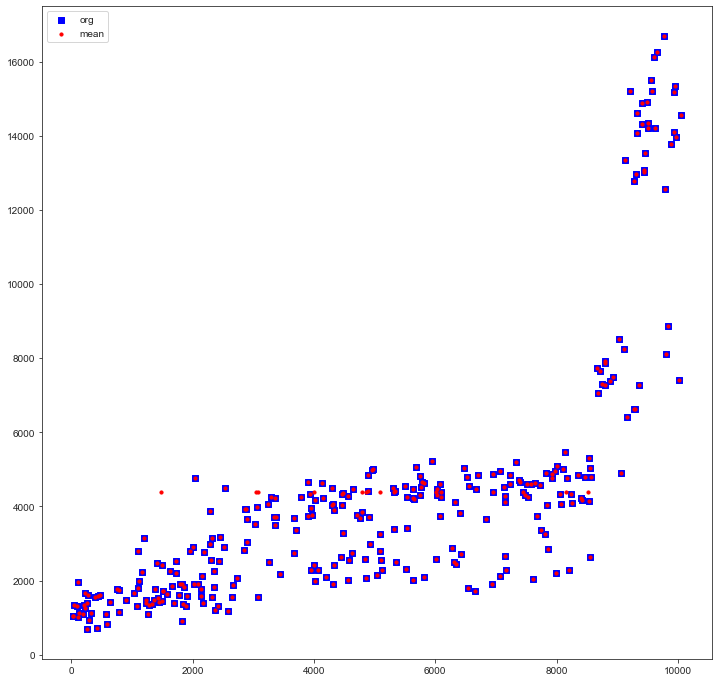

In [77]:
# visualisation (optionnelle) des données générées

fig = plt.figure(figsize=(12,12))
ax1 = fig.add_subplot(111)

ax1.scatter(_df['Total_Trans_Amt'].index,_df['Total_Trans_Amt'], c='b', marker="s", label='org')
ax1.scatter(_df_mean['Total_Trans_Amt'].index,_df_mean['Total_Trans_Amt'], s=10, c='r', marker="o", label='mean')
plt.legend(loc='upper left');
plt.show()

In [78]:
_df_mean['Total_Trans_Amt'].isna().sum()

0

In [79]:
trace=go.Scatter(
    y=_df_mean['Total_Trans_Amt'],
    x=_df['Total_Trans_Amt'].index,
    name="Walk-up",
    mode='markers'
)

In [80]:

fig = go.Figure(data=[trace])
fig.show()

In [81]:
_df_median= _df.copy()
# imputation par la moyenne: les NaN sont remplacés par la median

imp = SimpleImputer(missing_values=np.nan, strategy='median')
#Simple imputer expects a column vector, so converting the pandas Series
_df_median['Total_Trans_Amt'] = imp.fit_transform(_df_median['Total_Trans_Amt'].to_numpy().reshape(-1,1))


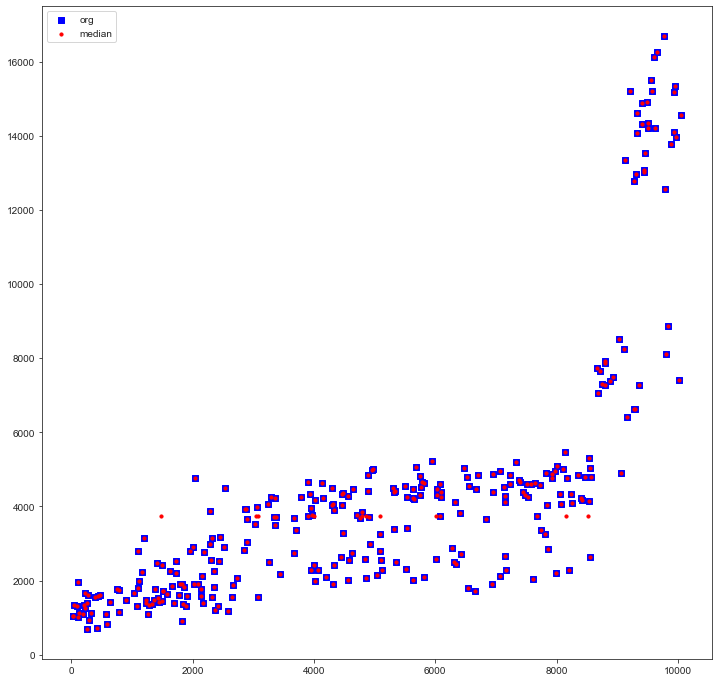

In [82]:
# visualisation (optionnelle) des données générées

fig = plt.figure(figsize=(12,12))
ax1 = fig.add_subplot(111)

ax1.scatter(_df['Total_Trans_Amt'].index,_df['Total_Trans_Amt'], c='b', marker="s", label='org')
ax1.scatter(_df_median['Total_Trans_Amt'].index,_df_median['Total_Trans_Amt'], s=10, c='r', marker="o", label='median')
plt.legend(loc='upper left');
plt.show()

In [83]:
_df_zero= _df.copy()
# imputation par la moyenne: les NaN sont remplacés par 0

imp = SimpleImputer(missing_values=np.nan, strategy='constant',fill_value=0)
#Simple imputer expects a column vector, so converting the pandas Series
_df_zero['Total_Trans_Amt'] = imp.fit_transform(_df_zero['Total_Trans_Amt'].to_numpy().reshape(-1,1))


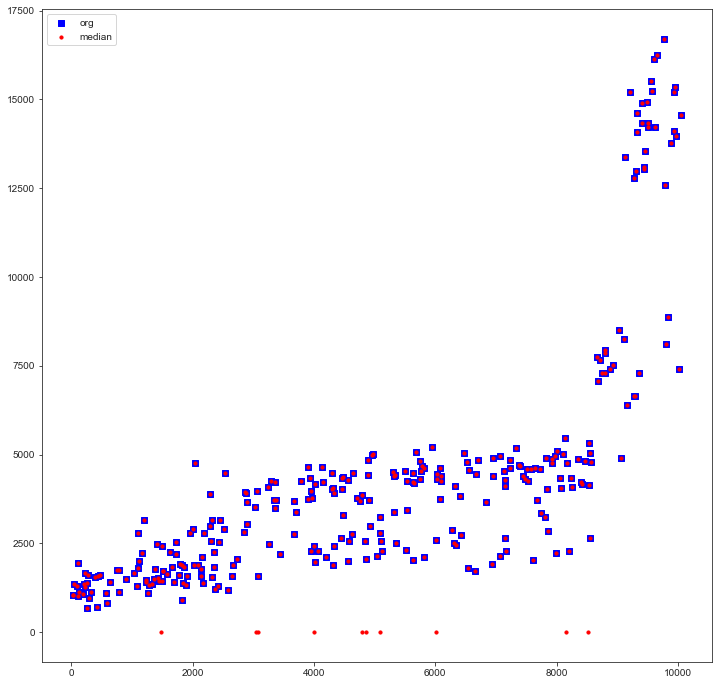

In [84]:
# visualisation (optionnelle) des données générées

fig = plt.figure(figsize=(12,12))
ax1 = fig.add_subplot(111)

ax1.scatter(_df['Total_Trans_Amt'].index,_df['Total_Trans_Amt'], c='b', marker="s", label='org')
ax1.scatter(_df_zero['Total_Trans_Amt'].index,_df_zero['Total_Trans_Amt'], s=10, c='r', marker="o", label='median')
plt.legend(loc='upper left');
plt.show()

In [85]:
_df_gen=_df.copy()
_df_gen['Gender'].isna().sum()


144

In [86]:
#sns.boxplot(_df['Gender'])

tr1=go.Box(x=_df['Gender'],name='Age Box Plot',boxmean=True)

fig = go.Figure(data=[tr1])
fig.show()

In [87]:
imp = SimpleImputer(missing_values=np.nan, strategy='most_frequent')
_df_gen['Gender'] = imp.fit_transform(_df_gen['Gender'].to_numpy().reshape(-1,1))
_df_gen['Gender'].isna().sum()

0

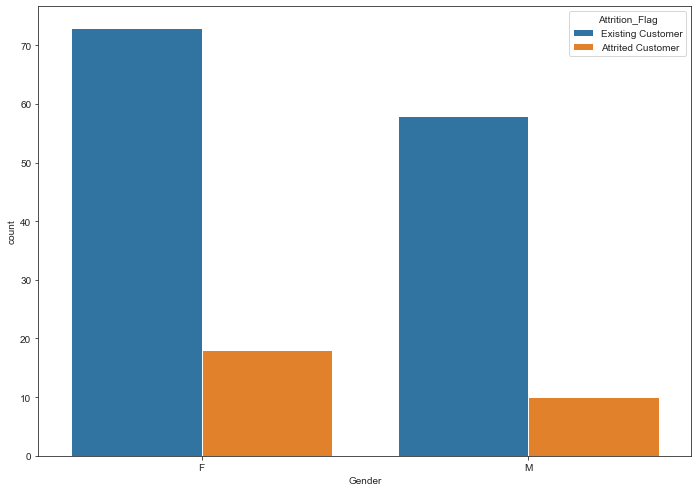

In [88]:
sns.set_style('ticks')
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
ax = sns.countplot(x="Gender",hue='Attrition_Flag' , data=_df)

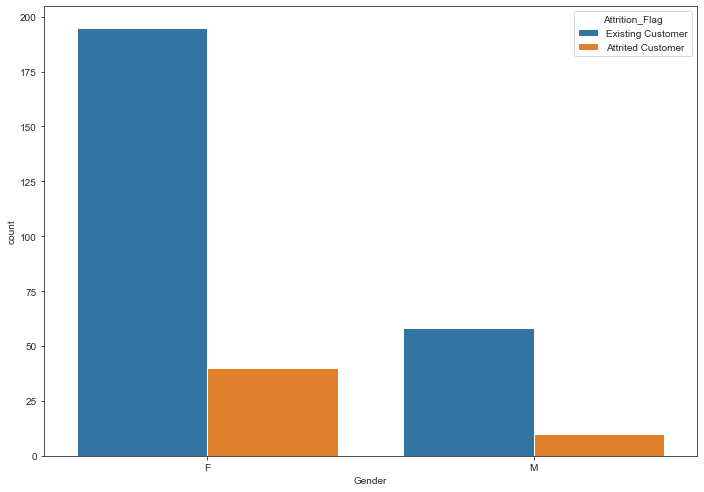

In [89]:
sns.set_style('ticks')
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
ax = sns.countplot(x="Gender",hue='Attrition_Flag' , data=_df_gen)

autre facon

In [90]:
# for each column, get value counts in decreasing order and take the index (value) of most common class
df_most_common_imputed = _df.apply(lambda x: x.fillna(x.value_counts().index[0]))
df_most_common_imputed

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Customer_Age_Categorized
1726,794562783,Existing Customer,28,F,0,Unknown,Single,Unknown,Blue,13,...,2,"21,691.00",661,"21,030.00",0.77,"2,534.00",51,0.96,0.03,"(25.953, 35.4]"
3780,716853258,Existing Customer,64,F,1,Graduate,Single,Less than $40K,Blue,45,...,2,"4,417.00",0,"4,417.00",0.90,"4,253.00",72,0.90,0.00,"(63.6, 73.0]"
300,819700533,Existing Customer,50,F,0,High School,Single,$120K +,Blue,45,...,3,"14,938.00",2303,"12,635.00",0.80,949.00,27,2.00,0.15,"(44.8, 54.2]"
5814,714246333,Attrited Customer,58,F,4,High School,Married,Unknown,Blue,48,...,3,"5,396.00",1803,"3,593.00",0.49,"2,107.00",39,0.39,0.33,"(54.2, 63.6]"
5531,712425258,Existing Customer,46,F,4,Unknown,Single,Less than $40K,Blue,26,...,3,"1,859.00",1379,480.00,0.84,"4,260.00",72,0.71,0.74,"(44.8, 54.2]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9938,720539583,Existing Customer,46,F,4,Unknown,Single,$60K - $80K,Blue,31,...,4,"21,226.00",1202,"20,024.00",0.76,"14,103.00",96,0.66,0.06,"(44.8, 54.2]"
8173,747074058,Existing Customer,47,F,3,Unknown,Single,Unknown,Blue,40,...,0,"7,114.00",1637,"5,477.00",0.70,"4,758.00",81,0.50,0.23,"(44.8, 54.2]"
6676,751150233,Existing Customer,43,F,5,Graduate,Single,Less than $40K,Blue,36,...,2,"1,438.30",0,"1,438.30",0.64,"4,459.00",65,0.48,0.00,"(35.4, 44.8]"
4318,713482608,Existing Customer,47,F,4,College,Married,$40K - $60K,Blue,35,...,2,"3,560.00",751,"2,809.00",1.10,"4,060.00",79,0.97,0.21,"(44.8, 54.2]"


In [93]:
# replace missing values with the column mean
#df['X1'] = df['X1'].fillna(df['X1'].mean())
#df['X2'] = df['X2'].fillna(df['X2'].median())
#df

In [94]:
_df.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Customer_Age_Categorized
1726,794562783,Existing Customer,28,NaN,0,Unknown,Single,Unknown,Blue,13,...,2,"21,691.00",661,"21,030.00",0.77,"2,534.00",51,0.96,0.03,"(25.953, 35.4]"
3780,716853258,Existing Customer,64,NaN,1,Graduate,Single,Less than $40K,NaN,45,...,2,"4,417.00",0,"4,417.00",0.90,"4,253.00",72,0.90,0.00,"(63.6, 73.0]"
300,819700533,Existing Customer,50,NaN,0,High School,Single,$120K +,NaN,45,...,3,"14,938.00",2303,"12,635.00",0.80,949.00,27,2.00,0.15,"(44.8, 54.2]"
5814,714246333,Attrited Customer,58,NaN,4,High School,Married,Unknown,NaN,48,...,3,"5,396.00",1803,"3,593.00",0.49,"2,107.00",39,0.39,0.33,"(54.2, 63.6]"
5531,712425258,Existing Customer,46,F,4,Unknown,Single,Less than $40K,Blue,26,...,3,"1,859.00",1379,480.00,0.84,"4,260.00",72,0.71,0.74,"(44.8, 54.2]"


Imputation par le centre du groupe

In [95]:
#_df['Gender'].isnull().any()
_dfx=_df.copy()
_dfx.shape

(303, 22)

In [96]:
 _df['Gender'].index

Int64Index([1726, 3780,  300, 5814, 5531, 2323, 4445, 6948, 6419, 6650,
            ...
            4850, 5105, 8411, 2369, 6030, 9938, 8173, 6676, 4318, 8562],
           dtype='int64', length=303)

In [97]:
index_with_nan = _df['Gender'].index[_df['Gender'].isnull()]
index_with_nan
for i in index_with_nan:
    _dfx.drop(i,0, inplace=True)
    
_dfx.shape

(159, 22)

In [98]:
 data_filtered1=_dfx.copy()

In [99]:
data_filtered1.columns

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'Customer_Age_Categorized'],
      dtype='object')

In [100]:
columns = ['CLIENTNUM', 'Attrition_Flag',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1',
       'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'Customer_Age_Categorized', 'Height']

print(columns)

['CLIENTNUM', 'Attrition_Flag', 'Dependent_count', 'Education_Level', 'Marital_Status', 'Income_Category', 'Card_Category', 'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon', 'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal', 'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio', 'Customer_Age_Categorized', 'Height']


In [102]:


data_filtered1['Gender']=data_filtered1['Gender'].apply(lambda x: 1 if x=='M' else 0 )

In [103]:
data_filtered1.drop('Total_Trans_Amt',1, inplace=True)

In [104]:
data_filtered1

,Customer_Age,Gender,Total_Trans_Ct
5531,46,0,72
2323,56,0,44
4445,49,0,43
6419,40,0,41
1099,48,1,67
...,...,...,...
9401,56,0,103
5105,39,0,48
8411,26,0,59
2369,56,1,19


In [105]:
colors_=['b','r']

Centres : [[47.13235294  0.48529412 40.35294118]
 [46.63736264  0.38461538 80.06593407]]


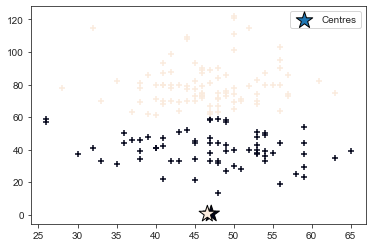

In [106]:
# application de la classification automatique aux observations complètes
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=2).fit(data_filtered1)
# affichage des centres obtenus pour les groupes
centers = kmeans.cluster_centers_
print("Centres : {}".format(centers))

plt.scatter(data_filtered1['Customer_Age'], data_filtered1['Total_Trans_Ct'], marker='+', c=kmeans.labels_)
plt.scatter(centers[:,0], centers[:,1], edgecolors='k', s=300, marker='*', label="Centres", c=range(len(centers)))
plt.legend()
plt.show()

<h1>La valeur aberrante</h1>


In [107]:
data.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Customer_Age_Categorized
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,3,"12,691.00",777,"11,914.00",1.33,1144,42,1.62,0.06,"(44.8, 54.2]"
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,2,"8,256.00",864,"7,392.00",1.54,1291,33,3.71,0.10,"(44.8, 54.2]"
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,0,"3,418.00",0,"3,418.00",2.59,1887,20,2.33,0.00,"(44.8, 54.2]"
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,1,"3,313.00",2517,796.00,1.41,1171,20,2.33,0.76,"(35.4, 44.8]"
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,0,"4,716.00",0,"4,716.00",2.17,816,28,2.50,0.00,"(35.4, 44.8]"


{'whiskers': [<matplotlib.lines.Line2D at 0x14c00c08>,
 'caps': [<matplotlib.lines.Line2D at 0x14c13e48>,
 'boxes': [<matplotlib.lines.Line2D at 0x14c13988>],
 'medians': [<matplotlib.lines.Line2D at 0x14c1af88>],
 'fliers': [<matplotlib.lines.Line2D at 0x14c1ac08>],
 'means': []}

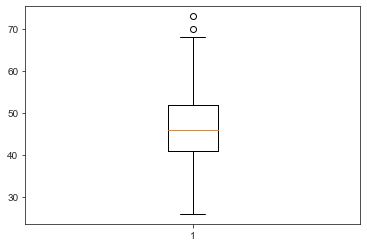

In [108]:
plt.boxplot(data['Customer_Age'])



In [109]:
fig0 = make_subplots(rows=1, cols=1)
tr0=go.Box(x=data['Total_Trans_Amt'],name='Total_Trans_Amt Box Plot',boxmean=True)

fig0.add_trace(tr0)

fig0.update_layout(height=400, width=800, title_text="Distribution des  des clients")
fig0.show()

<h1>Encodage</h1>

Commencons par Nominal variable

In [110]:
cleanup_nums = {"Gender":     {"M": 0, "F": 1},
                "Marital_Status": {"Single": 0, "Married": 1, "Unknown": 2, "Divorced": 3},
                "Attrition_Flag": {"Existing Customer":0 , "Attrited Customer": 1}}
data=data.copy()
data.replace(cleanup_nums, inplace=True)

In [111]:
data.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Customer_Age_Categorized
0,768805383,0,45,0,3,High School,1,$60K - $80K,Blue,39,...,3,"12,691.00",777,"11,914.00",1.33,1144,42,1.62,0.06,"(44.8, 54.2]"
1,818770008,0,49,1,5,Graduate,0,Less than $40K,Blue,44,...,2,"8,256.00",864,"7,392.00",1.54,1291,33,3.71,0.10,"(44.8, 54.2]"
2,713982108,0,51,0,3,Graduate,1,$80K - $120K,Blue,36,...,0,"3,418.00",0,"3,418.00",2.59,1887,20,2.33,0.00,"(44.8, 54.2]"
3,769911858,0,40,1,4,High School,2,Less than $40K,Blue,34,...,1,"3,313.00",2517,796.00,1.41,1171,20,2.33,0.76,"(35.4, 44.8]"
4,709106358,0,40,0,3,Uneducated,1,$60K - $80K,Blue,21,...,0,"4,716.00",0,"4,716.00",2.17,816,28,2.50,0.00,"(35.4, 44.8]"


One Hot Encode avec scikit-learn

In [112]:
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

data_oneh=data.copy()



In [113]:
# integer encode
label_encoder = LabelEncoder()
data_oneh['Gender'] = label_encoder.fit_transform(data_oneh['Gender'])


In [114]:
data_oneh['Gender']

0        0
1        1
2        0
3        1
4        0
        ..
10122    0
10123    0
10124    1
10125    0
10126    1
Name: Gender, Length: 10127, dtype: int64

In [115]:
# binary encode
data_oneh2=data.copy()

# binary encode
integer_encoded2 = label_encoder.fit_transform(data_oneh2['Card_Category'])
onehot_encoder = OneHotEncoder(sparse=False)
integer_encoded2 = integer_encoded2.reshape(len(data_oneh2['Card_Category']), 1)
onehot_encoded = onehot_encoder.fit_transform(integer_encoded2)
print(onehot_encoded)

[[1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 ...
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [0. 0. 0. 1.]]


In [116]:
data_oneh2['Card_Category'].unique()

array(['Blue', 'Gold', 'Silver', 'Platinum'], dtype=object)

In [117]:
from numpy import argmax
# invert le 1er exemple
inverted = label_encoder.inverse_transform([argmax(onehot_encoded[0, :])])
print(inverted)

['Blue']


In [118]:
data_oneh2['Income_Category'] = data_oneh2['Income_Category'].replace({'Unknown': 0 , 'Less than $40K':1, '$40K - $60K':2, 
                                                      '$80K - $120K':3, '$60K - $80K':4, '$120K +':5})

In [119]:
data_oneh2['Education_Level'] = data_oneh2['Education_Level'].replace({'Unknown': 0, 'High School':1, 'Graduate':2, 'Uneducated':3,
                                                         'College':4,'Post-Graduate':5,'Doctorate':6})

In [120]:
data_oneh2['Education_Level']

0        1
1        2
2        2
3        1
4        3
        ..
10122    2
10123    0
10124    1
10125    2
10126    2
Name: Education_Level, Length: 10127, dtype: int64

 pandas.get_dummies : Convertir les variables catégorielles en variables indicatrices ou fictives.

In [121]:
card_dummies = pd.get_dummies(data_oneh2['Card_Category'], prefix='Card')
marital_dummies = pd.get_dummies(data_oneh2['Marital_Status'], prefix='Marital')

In [122]:
card_dummies

,Card_Blue,Card_Gold,Card_Platinum,Card_Silver
0,1,0,0,0
1,1,0,0,0
2,1,0,0,0
3,1,0,0,0
4,1,0,0,0
...,...,...,...,...
10122,1,0,0,0
10123,1,0,0,0
10124,1,0,0,0
10125,1,0,0,0


In [123]:
data = pd.get_dummies(data, columns=["Education_Level", "Income_Category","Card_Category","Customer_Age_Categorized"], prefix=["education", "income", "card","age_cat"])

In [124]:
data.dtypes

CLIENTNUM                     int64
Attrition_Flag                int64
Customer_Age                  int64
Gender                        int64
Dependent_count               int64
Marital_Status                int64
Months_on_book                int64
Total_Relationship_Count      int64
Months_Inactive_12_mon        int64
Contacts_Count_12_mon         int64
Credit_Limit                float64
Total_Revolving_Bal           int64
Avg_Open_To_Buy             float64
Total_Amt_Chng_Q4_Q1        float64
Total_Trans_Amt               int64
Total_Trans_Ct                int64
Total_Ct_Chng_Q4_Q1         float64
Avg_Utilization_Ratio       float64
education_College             uint8
education_Doctorate           uint8
education_Graduate            uint8
education_High School         uint8
education_Post-Graduate       uint8
education_Uneducated          uint8
education_Unknown             uint8
income_$120K +                uint8
income_$40K - $60K            uint8
income_$60K - $80K          

In [125]:
data.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Marital_Status,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,...,income_Unknown,card_Blue,card_Gold,card_Platinum,card_Silver,"age_cat_(25.953, 35.4]","age_cat_(35.4, 44.8]","age_cat_(44.8, 54.2]","age_cat_(54.2, 63.6]","age_cat_(63.6, 73.0]"
0,768805383,0,45,0,3,1,39,5,1,3,...,0,1,0,0,0,0,0,1,0,0
1,818770008,0,49,1,5,0,44,6,1,2,...,0,1,0,0,0,0,0,1,0,0
2,713982108,0,51,0,3,1,36,4,1,0,...,0,1,0,0,0,0,0,1,0,0
3,769911858,0,40,1,4,2,34,3,4,1,...,0,1,0,0,0,0,1,0,0,0
4,709106358,0,40,0,3,1,21,5,1,0,...,0,1,0,0,0,0,1,0,0,0


In [126]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 40 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CLIENTNUM                 10127 non-null  int64  
 1   Attrition_Flag            10127 non-null  int64  
 2   Customer_Age              10127 non-null  int64  
 3   Gender                    10127 non-null  int64  
 4   Dependent_count           10127 non-null  int64  
 5   Marital_Status            10127 non-null  int64  
 6   Months_on_book            10127 non-null  int64  
 7   Total_Relationship_Count  10127 non-null  int64  
 8   Months_Inactive_12_mon    10127 non-null  int64  
 9   Contacts_Count_12_mon     10127 non-null  int64  
 10  Credit_Limit              10127 non-null  float64
 11  Total_Revolving_Bal       10127 non-null  int64  
 12  Avg_Open_To_Buy           10127 non-null  float64
 13  Total_Amt_Chng_Q4_Q1      10127 non-null  float64
 14  Total_

comment mettre à l'échelle nos données

La normalisation est une technique de mise à l'échelle populaire qui soustrait la moyenne des valeurs et la divise par l'écart type, transformant la distribution de probabilité d'une variable d'entrée en une gaussienne standard (moyenne nulle et variance unitaire). La normalisation peut devenir faussée ou biaisée si la variable d'entrée contient des valeurs aberrantes.

<AxesSubplot:xlabel='Attrition_Flag', ylabel='Total_Trans_Ct'>

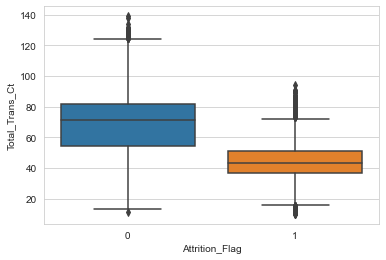

In [127]:
sns.set_style("whitegrid")
sns.boxplot(x = 'Attrition_Flag', y = 'Total_Trans_Ct', data = data)

In [128]:
data.columns

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Marital_Status', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'education_College', 'education_Doctorate', 'education_Graduate',
       'education_High School', 'education_Post-Graduate',
       'education_Uneducated', 'education_Unknown', 'income_$120K +',
       'income_$40K - $60K', 'income_$60K - $80K', 'income_$80K - $120K',
       'income_Less than $40K', 'income_Unknown', 'card_Blue', 'card_Gold',
       'card_Platinum', 'card_Silver', 'age_cat_(25.953, 35.4]',
       'age_cat_(35.4, 44.8]', 'age_cat_(44.8, 54.2]', 'age_cat_(54.2, 63.6]',
       'age_cat_(63.6, 73.0]'],
      dtype='object')

In [129]:
fig = make_subplots(rows=2, cols=1,shared_xaxes=True,subplot_titles=('Perason Correaltion',  'Spearman Correaltion'))
colorscale=     [[1.0              , "rgb(165,0,38)"],
                [0.8888888888888888, "rgb(215,48,39)"],
                [0.7777777777777778, "rgb(244,109,67)"],
                [0.6666666666666666, "rgb(253,174,97)"],
                [0.5555555555555556, "rgb(254,224,144)"],
                [0.4444444444444444, "rgb(224,243,248)"],
                [0.3333333333333333, "rgb(171,217,233)"],
                [0.2222222222222222, "rgb(116,173,209)"],
                [0.1111111111111111, "rgb(69,117,180)"],
                [0.0               , "rgb(49,54,149)"]]

s_val =data.corr('pearson')
s_idx = s_val.index
s_col = s_val.columns
s_val = s_val.values
fig.add_trace(
    go.Heatmap(x=s_col,y=s_idx,z=s_val,name='pearson',showscale=False,xgap=0.7,ygap=0.7,colorscale=colorscale),
    row=1, col=1
)


s_val =data.corr('spearman')
s_idx = s_val.index
s_col = s_val.columns
s_val = s_val.values
fig.add_trace(
    go.Heatmap(x=s_col,y=s_idx,z=s_val,xgap=0.7,ygap=0.7,colorscale=colorscale),
    row=2, col=1
)
fig.update_layout(
    hoverlabel=dict(
        bgcolor="white",
        font_size=16,
        font_family="Rockwell"
    )
)
fig.update_layout(height=700, width=900, title_text="Numeric Correaltions")
fig.show()

bining backiting and 

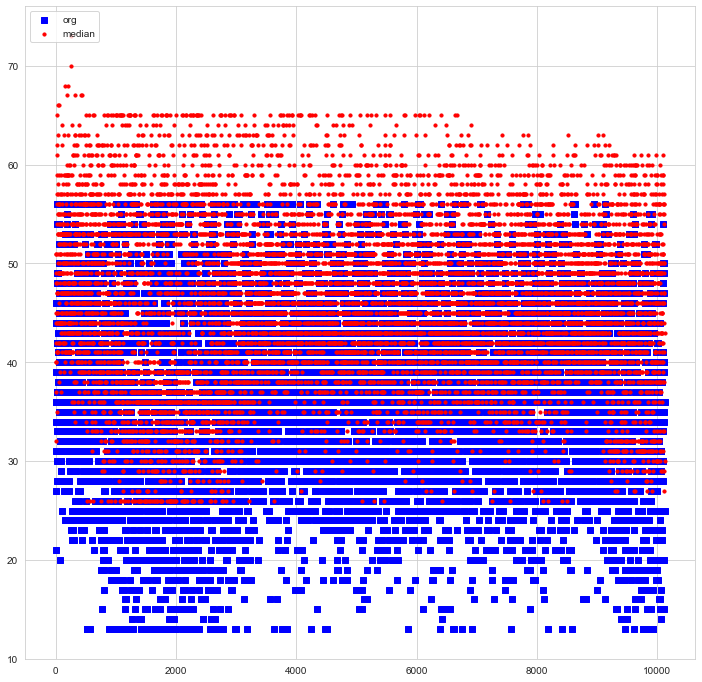

In [130]:
# visualisation (optionnelle) des données générées

fig = plt.figure(figsize=(12,12))
ax1 = fig.add_subplot(111)

ax1.scatter(data['Months_on_book'].index,data['Months_on_book'], c='b', marker="s", label='org')
ax1.scatter(data['Customer_Age'].index,data['Customer_Age'], s=10, c='r', marker="o", label='median')
plt.legend(loc='upper left');
plt.show()

In [131]:
data.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Marital_Status,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,...,income_Unknown,card_Blue,card_Gold,card_Platinum,card_Silver,"age_cat_(25.953, 35.4]","age_cat_(35.4, 44.8]","age_cat_(44.8, 54.2]","age_cat_(54.2, 63.6]","age_cat_(63.6, 73.0]"
0,768805383,0,45,0,3,1,39,5,1,3,...,0,1,0,0,0,0,0,1,0,0
1,818770008,0,49,1,5,0,44,6,1,2,...,0,1,0,0,0,0,0,1,0,0
2,713982108,0,51,0,3,1,36,4,1,0,...,0,1,0,0,0,0,0,1,0,0
3,769911858,0,40,1,4,2,34,3,4,1,...,0,1,0,0,0,0,1,0,0,0
4,709106358,0,40,0,3,1,21,5,1,0,...,0,1,0,0,0,0,1,0,0,0


Data Upsampling Using SMOTE

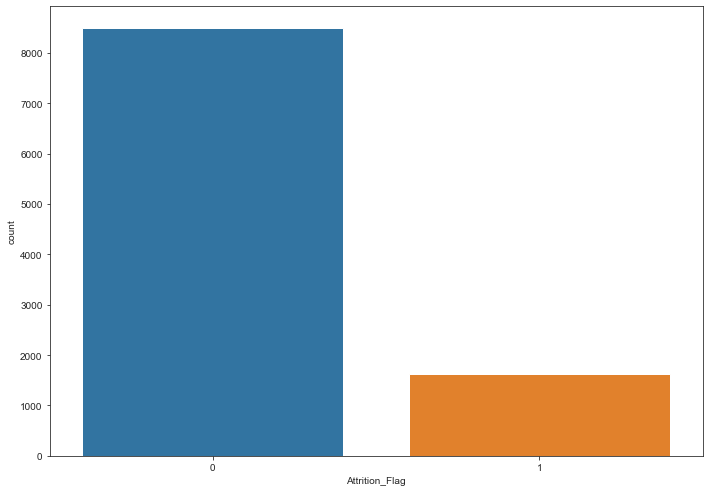

In [132]:

sns.set_style('ticks')
fig, ax = plt.subplots()
# the size of A4 paper
fig.set_size_inches(11.7, 8.27)
ax = sns.countplot(x="Attrition_Flag" , data=data)

In [133]:
xx=data.groupby(['Attrition_Flag']).count()
xx['CLIENTNUM']

Attrition_Flag
0    8500
1    1627
Name: CLIENTNUM, dtype: int64

In [134]:
trace = go.Bar(y=xx['CLIENTNUM'],
               x=xx.index,
               name="One Way",
                hovertemplate="%{y}",
   marker=dict(color="#FF8000")
              )
fig = go.Figure(data=[trace])
fig.show()

In [135]:
ex.pie(data,names='Attrition_Flag',title='Propotion Of Attrition_Flag',hole=0.3)

In [136]:
Xb=data[data.columns[2:]]
yb=data[data.columns[1]]

In [137]:
print("y 1 avant sampling    ", sum(yb==1))
print("y 0 avant sampling      ",sum(yb==0))

print("X avant sampling      ",Xb.shape)


y 1 avant sampling     1627
y 0 avant sampling       8500
X avant sampling       (10127, 38)


In [138]:
#%pip install imbalanced-learn
from imblearn.over_sampling import SMOTE

oversample = SMOTE()
X, y = oversample.fit_resample(data[data.columns[2:]], data[data.columns[1]])
usampled_df = X.assign(Churn = y)

ohe_data =usampled_df[usampled_df.columns[15:-1]].copy()

usampled_df = usampled_df.drop(columns=usampled_df.columns[15:-1])

In [139]:
usampled_df

,Customer_Age,Gender,Dependent_count,Marital_Status,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Churn
0,45,0,3,1,39,5,1,3,"12,691.00",777,"11,914.00",1.33,1144,42,1.62,0
1,49,1,5,0,44,6,1,2,"8,256.00",864,"7,392.00",1.54,1291,33,3.71,0
2,51,0,3,1,36,4,1,0,"3,418.00",0,"3,418.00",2.59,1887,20,2.33,0
3,40,1,4,2,34,3,4,1,"3,313.00",2517,796.00,1.41,1171,20,2.33,0
4,40,0,3,1,21,5,1,0,"4,716.00",0,"4,716.00",2.17,816,28,2.50,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16995,47,1,2,0,33,2,3,3,"3,090.60",917,"2,173.35",0.64,2385,43,0.46,1
16996,52,0,1,0,36,3,2,2,"11,763.59",0,"11,763.59",0.62,2186,43,0.38,1
16997,53,1,2,0,45,4,0,3,"2,420.59",0,"2,420.59",0.75,2580,39,0.58,1
16998,49,1,3,0,37,2,3,2,"4,626.13",848,"3,777.35",0.66,2294,47,0.99,1


In [140]:
print(sum(y==1))
print(sum(y==0))
print(X.shape)

8500
8500
(17000, 38)


In [141]:
ex.pie(y,names='Attrition_Flag',title='Propotion Of Attrition_Flag',hole=0.3)

Scaling et Standarisation

In [142]:
#sauvgardons les données categorical
categorical_data = data[["education_College","education_Doctorate","education_Graduate","education_High School","education_Post-Graduate","education_Uneducated",
                        "education_Unknown","income_$120K +","income_$40K - $60K","income_$60K - $80K","income_$80K - $120K","income_Less than $40K","income_Unknown",
                        "card_Blue","card_Gold","card_Platinum","card_Silver","age_cat_(25.953, 35.4]","age_cat_(35.4, 44.8]","age_cat_(44.8, 54.2]","age_cat_(54.2, 63.6]",
                        "age_cat_(63.6, 73.0]"]]

In [143]:
y = data["Attrition_Flag"]
#suprimer les données categorical
X = data.drop(["Attrition_Flag","education_College","education_Doctorate","education_Graduate","education_High School","education_Post-Graduate","education_Uneducated",
                        "education_Unknown","income_$120K +","income_$40K - $60K","income_$60K - $80K","income_$80K - $120K","income_Less than $40K","income_Unknown",
                        "card_Blue","card_Gold","card_Platinum","card_Silver","age_cat_(25.953, 35.4]","age_cat_(35.4, 44.8]","age_cat_(44.8, 54.2]","age_cat_(54.2, 63.6]",
                        "age_cat_(63.6, 73.0]"], axis = 1)
cols = X.columns
index = X.index

In [144]:
X.head()

,CLIENTNUM,Customer_Age,Gender,Dependent_count,Marital_Status,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,45,0,3,1,39,5,1,3,"12,691.00",777,"11,914.00",1.33,1144,42,1.62,0.06
1,818770008,49,1,5,0,44,6,1,2,"8,256.00",864,"7,392.00",1.54,1291,33,3.71,0.10
2,713982108,51,0,3,1,36,4,1,0,"3,418.00",0,"3,418.00",2.59,1887,20,2.33,0.00
3,769911858,40,1,4,2,34,3,4,1,"3,313.00",2517,796.00,1.41,1171,20,2.33,0.76
4,709106358,40,0,3,1,21,5,1,0,"4,716.00",0,"4,716.00",2.17,816,28,2.50,0.00


In [145]:
print(X.shape, y.shape)

(10127, 17) (10127,)


In [146]:
from sklearn import preprocessing
transformer = preprocessing.RobustScaler().fit(X)
X = transformer.transform(X)
X = pd.DataFrame(X, columns = cols, index = index)


In [147]:
#add les données categorical
X = pd.concat([X,categorical_data], axis = 1)

In [148]:
X.head()

,CLIENTNUM,Customer_Age,Gender,Dependent_count,Marital_Status,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,...,income_Unknown,card_Blue,card_Gold,card_Platinum,card_Silver,"age_cat_(25.953, 35.4]","age_cat_(35.4, 44.8]","age_cat_(44.8, 54.2]","age_cat_(54.2, 63.6]","age_cat_(63.6, 73.0]"
0,0.85,-0.09,-1.00,0.50,0.00,0.33,0.50,-1.00,1.00,0.96,...,0,1,0,0,0,0,0,1,0,0
1,1.68,0.27,0.00,1.50,-1.00,0.89,1.00,-1.00,0.00,0.44,...,0,1,0,0,0,0,0,1,0,0
2,-0.07,0.45,-1.00,0.50,0.00,0.00,0.00,-1.00,-2.00,-0.13,...,0,1,0,0,0,0,0,1,0,0
3,0.86,-0.55,0.00,1.00,1.00,-0.22,-0.50,2.00,-1.00,-0.15,...,0,1,0,0,0,0,1,0,0,0
4,-0.15,-0.55,-1.00,0.50,0.00,-1.67,0.50,-1.00,-2.00,0.02,...,0,1,0,0,0,0,1,0,0,0


In [149]:
print("X.shape:",X.shape)
print("y.shape",y.shape)

X.shape: (10127, 39)
y.shape (10127,)


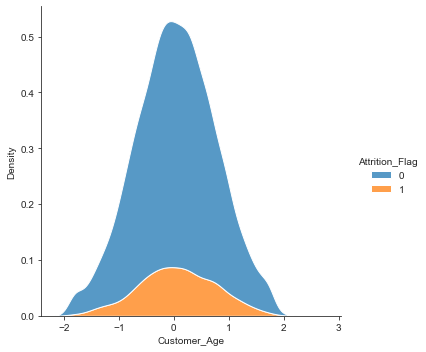

In [150]:
#visualizer
Xf = pd.concat([X,y], axis = 1)
ax=sns.displot(Xf, x="Customer_Age", hue="Attrition_Flag", kind="kde", multiple="stack")

Feature selection

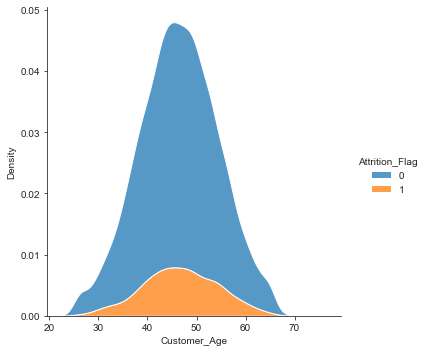

In [151]:
ax=sns.displot(data, x="Customer_Age", hue="Attrition_Flag", kind="kde", multiple="stack")

Text(0.5, 1.0, 'after rebustScaling')

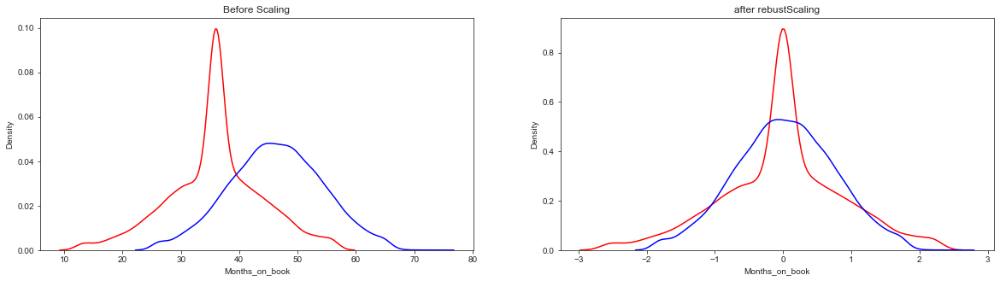

In [152]:
fig, (ax1, ax2) = plt.subplots(ncols = 2, figsize =(20, 5))
ax1.set_title('Before Scaling')
 
sns.kdeplot(data['Months_on_book'], ax = ax1, color ='r')
sns.kdeplot(data['Customer_Age'], ax = ax1, color ='b')


sns.kdeplot(Xf['Months_on_book'], ax = ax2, color ='r')
sns.kdeplot(Xf['Customer_Age'], ax = ax2, color ='b')
ax2.set_title('after rebustScaling')

In [153]:
scaler = preprocessing.StandardScaler()
standard_df = scaler.fit_transform(X)
standard_df = pd.DataFrame(standard_df, columns = X.columns)
 
scaler = preprocessing.MinMaxScaler()
minmax_df = scaler.fit_transform(X)
minmax_df = pd.DataFrame(minmax_df, columns = X.columns)

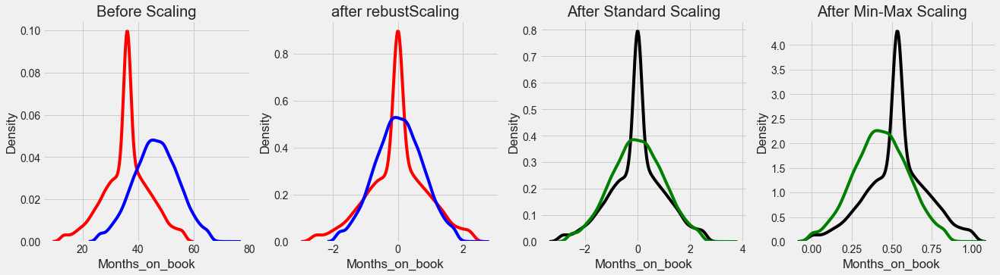

In [154]:
import matplotlib
%matplotlib inline
matplotlib.style.use('fivethirtyeight')
 
fig, (ax1, ax2, ax3, ax4) = plt.subplots(ncols = 4, figsize =(20, 5))
ax1.set_title('Before Scaling')

sns.kdeplot(data['Months_on_book'], ax = ax1, color ='r')
sns.kdeplot(data['Customer_Age'], ax = ax1, color ='b')

ax2.set_title('after rebustScaling')
sns.kdeplot(Xf['Months_on_book'], ax = ax2, color ='r')
sns.kdeplot(Xf['Customer_Age'], ax = ax2, color ='b')


ax3.set_title('After Standard Scaling')
sns.kdeplot(standard_df['Months_on_book'], ax = ax3, color ='black')
sns.kdeplot(standard_df['Customer_Age'], ax = ax3, color ='g')

ax4.set_title('After Min-Max Scaling')
 
sns.kdeplot(minmax_df['Months_on_book'], ax = ax4, color ='black')
sns.kdeplot(minmax_df['Customer_Age'], ax = ax4, color ='g')
plt.show()

In [155]:
xd=X.describe()

In [156]:
dd=data.describe()

In [157]:
rr=dd-xd

In [158]:
rr

,Attrition_Flag,Avg_Open_To_Buy,Avg_Utilization_Ratio,CLIENTNUM,Contacts_Count_12_mon,Credit_Limit,Customer_Age,Dependent_count,Gender,Marital_Status,...,education_High School,education_Post-Graduate,education_Uneducated,education_Unknown,income_$120K +,income_$40K - $60K,income_$60K - $80K,income_$80K - $120K,income_Less than $40K,income_Unknown
count,nan,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
mean,nan,"7,468.67",0.07,"739,177,605.98",2.00,"8,631.47",46.30,2.17,1.00,1.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
std,nan,"9,089.62",-0.30,"36,903,782.84",0.00,"9,087.71",7.29,0.65,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
min,nan,3.41,0.37,"708,082,083.16",2.00,"1,438.67",27.82,1.00,1.00,1.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,nan,"1,324.75",0.34,"713,036,770.58",2.00,"2,555.23",41.45,1.50,1.00,1.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
50%,nan,"3,474.00",0.18,"717,926,358.00",2.00,"4,549.00",46.00,2.00,1.00,1.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
75%,nan,"9,858.25",-0.18,"773,143,532.08",2.00,"11,066.73",51.45,2.50,1.00,1.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
max,nan,"34,512.36",-0.72,"828,343,081.16",2.00,"34,512.48",70.55,3.50,1.00,1.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


In [159]:
variance = np.var(X)

In [160]:
variance

CLIENTNUM                  0.38
Customer_Age               0.53
Gender                     0.25
Dependent_count            0.42
Marital_Status             0.73
Months_on_book             0.79
Total_Relationship_Count   0.60
Months_Inactive_12_mon     1.02
Contacts_Count_12_mon      1.22
Credit_Limit               1.14
Total_Revolving_Bal        0.33
Avg_Open_To_Buy            1.13
Total_Amt_Chng_Q4_Q1       0.92
Total_Trans_Amt            1.73
Total_Trans_Ct             0.43
Total_Ct_Chng_Q4_Q1        1.02
Avg_Utilization_Ratio      0.33
education_College          0.09
education_Doctorate        0.04
education_Graduate         0.21
education_High School      0.16
education_Post-Graduate    0.05
education_Uneducated       0.13
education_Unknown          0.13
income_$120K +             0.07
income_$40K - $60K         0.15
income_$60K - $80K         0.12
income_$80K - $120K        0.13
income_Less than $40K      0.23
income_Unknown             0.10
card_Blue                  0.06
card_Gol

Feature selecting

In [161]:
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE

lg=LogisticRegression(solver='lbfgs', max_iter=1000)
rfe = RFE(estimator=lg, n_features_to_select=3)
# fit RFE
rfe.fit(X, y)
# summarize all features
for i in range(X.shape[1]):
    print('Column: %d, Selected %s, Rank: %.3f' % (i, rfe.support_[i], rfe.ranking_[i]))

Column: 0, Selected False, Rank: 12.000
Column: 1, Selected False, Rank: 20.000
Column: 2, Selected False, Rank: 6.000
Column: 3, Selected False, Rank: 21.000
Column: 4, Selected False, Rank: 24.000
Column: 5, Selected False, Rank: 37.000
Column: 6, Selected False, Rank: 3.000
Column: 7, Selected False, Rank: 10.000
Column: 8, Selected False, Rank: 7.000
Column: 9, Selected False, Rank: 23.000
Column: 10, Selected True, Rank: 1.000
Column: 11, Selected False, Rank: 35.000
Column: 12, Selected False, Rank: 29.000
Column: 13, Selected True, Rank: 1.000
Column: 14, Selected True, Rank: 1.000
Column: 15, Selected False, Rank: 4.000
Column: 16, Selected False, Rank: 25.000
Column: 17, Selected False, Rank: 33.000
Column: 18, Selected False, Rank: 13.000
Column: 19, Selected False, Rank: 30.000
Column: 20, Selected False, Rank: 31.000
Column: 21, Selected False, Rank: 14.000
Column: 22, Selected False, Rank: 34.000
Column: 23, Selected False, Rank: 36.000
Column: 24, Selected False, Rank: 11

In [162]:
# explore the algorithm wrapped by RFE
from numpy import mean
from numpy import std
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.linear_model import Perceptron
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.pipeline import Pipeline


# get a list of models to evaluate
def get_models():
	models = dict()
	# lr
	rfe = RFE(estimator=LogisticRegression(), n_features_to_select=5)
	model = DecisionTreeClassifier()
	models['lr'] = Pipeline(steps=[('s',rfe),('m',model)])
	# perceptron
	rfe = RFE(estimator=Perceptron(), n_features_to_select=5)
	model = DecisionTreeClassifier()
	models['per'] = Pipeline(steps=[('s',rfe),('m',model)])
	# cart
	rfe = RFE(estimator=DecisionTreeClassifier(), n_features_to_select=5)
	model = DecisionTreeClassifier()
	models['cart'] = Pipeline(steps=[('s',rfe),('m',model)])
	# rf
	rfe = RFE(estimator=RandomForestClassifier(), n_features_to_select=5)
	model = DecisionTreeClassifier()
	models['rf'] = Pipeline(steps=[('s',rfe),('m',model)])
	# gbm
	rfe = RFE(estimator=GradientBoostingClassifier(), n_features_to_select=5)
	model = DecisionTreeClassifier()
	models['gbm'] = Pipeline(steps=[('s',rfe),('m',model)])
	return models

# evaluate a give model using cross-validation
def evaluate_model(model, X, y):
	cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
	scores = cross_val_score(model, X, y, scoring='accuracy', cv=cv, n_jobs=-1)
	return scores


# get the models to evaluate
models = get_models()
# evaluate the models and store results
results, names = list(), list()
for name, model in models.items():
	scores = evaluate_model(model, X, y)
	results.append(scores)
	names.append(name)
	print('>%s %.3f (%.3f)' % (name, mean(scores), std(scores)))
# plot model performance for comparison
plt.boxplot(results, labels=names, showmeans=True)
plt.show()

>lr 0.918 (0.006)
>per 0.859 (0.028)
>cart 0.929 (0.008)


KeyboardInterrupt: 

Feature importance

cas de la RegLogistic

Feature: 0, Score: -0.26873
Feature: 1, Score: 0.15266
Feature: 2, Score: 0.74191
Feature: 3, Score: 0.16130
Feature: 4, Score: -0.10515
Feature: 5, Score: 0.00975
Feature: 6, Score: -0.90619
Feature: 7, Score: 0.50385
Feature: 8, Score: 0.51428
Feature: 9, Score: -0.18963
Feature: 10, Score: -1.30260
Feature: 11, Score: 0.02887
Feature: 12, Score: -0.08898
Feature: 13, Score: 1.19660
Feature: 14, Score: -4.11870
Feature: 15, Score: -0.66878
Feature: 16, Score: -0.09821
Feature: 17, Score: -0.09188
Feature: 18, Score: 0.19129
Feature: 19, Score: -0.13787
Feature: 20, Score: -0.12381
Feature: 21, Score: 0.18215
Feature: 22, Score: -0.05966
Feature: 23, Score: 0.01790
Feature: 24, Score: 0.45963
Feature: 25, Score: -0.27346
Feature: 26, Score: -0.12175
Feature: 27, Score: 0.18385
Feature: 28, Score: -0.10889
Feature: 29, Score: -0.16126
Feature: 30, Score: -0.58253
Feature: 31, Score: 0.39881
Feature: 32, Score: 0.24925
Feature: 33, Score: -0.08742
Feature: 34, Score: 0.38498
Feature: 35

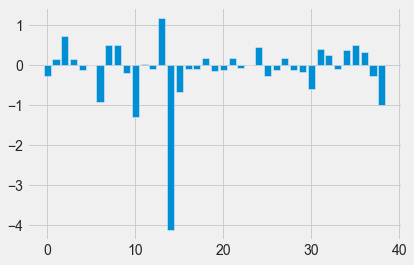

In [178]:
# define the model
model = LogisticRegression(solver='lbfgs', max_iter=1000)
# fit the model
model.fit(X, y)
# get importance
importance = model.coef_[0]
# summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
plt.bar([x for x in range(len(importance))], importance)
plt.show()

Cas des Decision Tree 

Feature: 0, Score: 0.01223
Feature: 1, Score: 0.03051
Feature: 2, Score: 0.00088
Feature: 3, Score: 0.00532
Feature: 4, Score: 0.00679
Feature: 5, Score: 0.00701
Feature: 6, Score: 0.08817
Feature: 7, Score: 0.01590
Feature: 8, Score: 0.01644
Feature: 9, Score: 0.01441
Feature: 10, Score: 0.18883
Feature: 11, Score: 0.01648
Feature: 12, Score: 0.04266
Feature: 13, Score: 0.14681
Feature: 14, Score: 0.29498
Feature: 15, Score: 0.07795
Feature: 16, Score: 0.00934
Feature: 17, Score: 0.00280
Feature: 18, Score: 0.00095
Feature: 19, Score: 0.00000
Feature: 20, Score: 0.00011
Feature: 21, Score: 0.00044
Feature: 22, Score: 0.00151
Feature: 23, Score: 0.00159
Feature: 24, Score: 0.00074
Feature: 25, Score: 0.00059
Feature: 26, Score: 0.00099
Feature: 27, Score: 0.00122
Feature: 28, Score: 0.00071
Feature: 29, Score: 0.00047
Feature: 30, Score: 0.00000
Feature: 31, Score: 0.00065
Feature: 32, Score: 0.00073
Feature: 33, Score: 0.00391
Feature: 34, Score: 0.00179
Feature: 35, Score: 0.00194
Fe

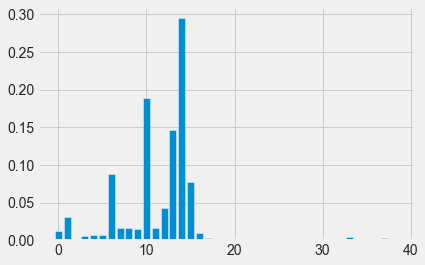

In [165]:
from sklearn.tree import DecisionTreeRegressor

modeltree = DecisionTreeRegressor()
# fit the model
modeltree.fit(X, y)
# get importance
importance = modeltree.feature_importances_
# summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
plt.bar([x for x in range(len(importance))], importance)
plt.show()

Importance des Features de classification XGBoost

In [ ]:

from xgboost import XGBClassifier

model = XGBClassifier()
# fit the model
model.fit(X, y)
# get importance
importance = model.feature_importances_
# summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
plt.bar([x for x in range(len(importance))], importance)
plt.show()

Permutation feature importance with knn for regression

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:442: UserWarning:

X does not have valid feature names, but KNeighborsRegressor was fitted with feature names

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:442: UserWarning:

X does not have valid feature names, but KNeighborsRegressor was fitted with feature names

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:442: UserWarning:

X does not have valid feature names, but KNeighborsRegressor was fitted with feature names

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:442: UserWarning:

X does not have valid feature names, but KNeighborsRegressor was fitted with feature names

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:442: UserWarning:

X does not have valid feature names, but KNeighborsRegressor was fitted with feature names

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:442: UserWarning:

X does not have valid feature names, but KNeighborsRegressor was fitted 

Feature: 0, Score: 0.00009
Feature: 1, Score: 0.00077
Feature: 2, Score: 0.00063
Feature: 3, Score: 0.00049
Feature: 4, Score: 0.00111
Feature: 5, Score: 0.00241
Feature: 6, Score: 0.00569
Feature: 7, Score: 0.00825
Feature: 8, Score: 0.00694
Feature: 9, Score: 0.00117
Feature: 10, Score: 0.00680
Feature: 11, Score: 0.00080
Feature: 12, Score: 0.00603
Feature: 13, Score: 0.01986
Feature: 14, Score: 0.01273
Feature: 15, Score: 0.01341
Feature: 16, Score: 0.00285
Feature: 17, Score: -0.00018
Feature: 18, Score: -0.00020
Feature: 19, Score: -0.00077
Feature: 20, Score: -0.00032
Feature: 21, Score: -0.00014
Feature: 22, Score: 0.00009
Feature: 23, Score: -0.00012
Feature: 24, Score: 0.00002
Feature: 25, Score: -0.00076
Feature: 26, Score: -0.00039
Feature: 27, Score: -0.00029
Feature: 28, Score: -0.00061
Feature: 29, Score: -0.00017
Feature: 30, Score: -0.00020
Feature: 31, Score: 0.00003
Feature: 32, Score: 0.00000
Feature: 33, Score: -0.00032
Feature: 34, Score: 0.00018
Feature: 35, Scor

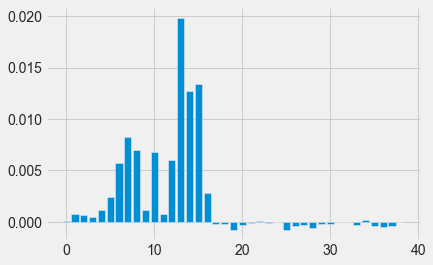

In [167]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.inspection import permutation_importance

model = KNeighborsRegressor()
# fit the model
model.fit(X, y)
# perform permutation importance
results = permutation_importance(model, X, y, scoring='neg_mean_squared_error')
# get importance
importance = results.importances_mean
# summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
plt.bar([x for x in range(len(importance))], importance)
plt.show()

PCA: Principal Component Analysis Of One Hot Encoded Data

Nous pouvons utilisé l'analyse en composantes principales pour réduire la dimensionnalité des variables catégorielles codées avec oneHot..., en perdant une partie des variances, mais simultanément, l'utilisation de quelques composantes principales au lieu de dizaines de caractéristiques codées à chaud nous aidera à construire un meilleur modèle.

In [ ]:
ohe_data

In [169]:
from sklearn.decomposition import PCA
N_COMPONENTS = 4

pca_model = PCA(n_components = N_COMPONENTS )

pc_matrix = pca_model.fit_transform(ohe_data)

evr = pca_model.explained_variance_ratio_
total_var = evr.sum() * 100
cumsum_evr = np.cumsum(evr)



Visualisation

In [170]:
trace1 = {
    "name": "individual explained variance", 
    "type": "bar", 
    'y':evr}
trace2 = {
    "name": "cumulative explained variance", 
    "type": "scatter", 
     'y':cumsum_evr}
data = [trace1, trace2]
layout = {
    "xaxis": {"title": "Principal components"}, 
    "yaxis": {"title": "Explained variance ratio"},
  }
fig = go.Figure(data=data, layout=layout)
fig.update_layout(     title='Explained Variance Using {} Dimensions'.format(N_COMPONENTS))
fig.show()

In [171]:
usampled_df

,Customer_Age,Gender,Dependent_count,Marital_Status,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Churn
0,45,0,3,1,39,5,1,3,"12,691.00",777,"11,914.00",1.33,1144,42,1.62,0
1,49,1,5,0,44,6,1,2,"8,256.00",864,"7,392.00",1.54,1291,33,3.71,0
2,51,0,3,1,36,4,1,0,"3,418.00",0,"3,418.00",2.59,1887,20,2.33,0
3,40,1,4,2,34,3,4,1,"3,313.00",2517,796.00,1.41,1171,20,2.33,0
4,40,0,3,1,21,5,1,0,"4,716.00",0,"4,716.00",2.17,816,28,2.50,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16995,47,1,2,0,33,2,3,3,"3,090.60",917,"2,173.35",0.64,2385,43,0.46,1
16996,52,0,1,0,36,3,2,2,"11,763.59",0,"11,763.59",0.62,2186,43,0.38,1
16997,53,1,2,0,45,4,0,3,"2,420.59",0,"2,420.59",0.75,2580,39,0.58,1
16998,49,1,3,0,37,2,3,2,"4,626.13",848,"3,777.35",0.66,2294,47,0.99,1


In [172]:
usampled_df_with_pcs = pd.concat([usampled_df,pd.DataFrame(pc_matrix,columns=['PC-{}'.format(i) for i in range(0,N_COMPONENTS)])],axis=1)

In [173]:
fig = ex.scatter_matrix(
    usampled_df_with_pcs[['PC-{}'.format(i) for i in range(0,N_COMPONENTS)]].values,
    color=usampled_df_with_pcs.Credit_Limit,
    dimensions=range(N_COMPONENTS),
    labels={str(i):'PC-{}'.format(i) for i in range(0,N_COMPONENTS)},
    title=f'Total Explained Variance: {total_var:.2f}%')

fig.update_traces(diagonal_visible=False)
fig.update_layout(
    coloraxis_colorbar=dict(
        title="Credit_Limit",
    ),
)
fig.show()

In [174]:
labels = {str(i): f"PC {i+1}" for i in range(N_COMPONENTS)}
labels['color'] = 'Median Price'

fig = px.scatter_matrix(
    pc_matrix,
    color=usampled_df_with_pcs.Credit_Limit,
    dimensions=range(N_COMPONENTS),
    labels=labels,
    title=f'Total Explained Variance: {total_var:.2f}%',
)
fig.update_traces(diagonal_visible=False)
fig.show()

visialisation des Components

In [175]:
fig = px.scatter(pc_matrix, x=0, y=1, color=usampled_df_with_pcs.Total_Trans_Amt)
fig.show()

In [176]:
usampled_df_with_pcs

,Customer_Age,Gender,Dependent_count,Marital_Status,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Churn,PC-0,PC-1,PC-2,PC-3
0,45,0,3,1,39,5,1,3,"12,691.00",777,"11,914.00",1.33,1144,42,1.62,0,-0.68,-0.34,-0.31,-0.46
1,49,1,5,0,44,6,1,2,"8,256.00",864,"7,392.00",1.54,1291,33,3.71,0,-0.63,0.88,0.67,-0.05
2,51,0,3,1,36,4,1,0,"3,418.00",0,"3,418.00",2.59,1887,20,2.33,0,-0.74,-0.22,0.88,-0.13
3,40,1,4,2,34,3,4,1,"3,313.00",2517,796.00,1.41,1171,20,2.33,0,0.78,0.73,-0.43,-0.68
4,40,0,3,1,21,5,1,0,"4,716.00",0,"4,716.00",2.17,816,28,2.50,0,0.70,-0.43,-0.10,-0.49
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16995,47,1,2,0,33,2,3,3,"3,090.60",917,"2,173.35",0.64,2385,43,0.46,1,0.12,-0.25,-0.30,0.27
16996,52,0,1,0,36,3,2,2,"11,763.59",0,"11,763.59",0.62,2186,43,0.38,1,-0.73,-0.39,-0.03,-0.22
16997,53,1,2,0,45,4,0,3,"2,420.59",0,"2,420.59",0.75,2580,39,0.58,1,0.18,0.60,-0.32,0.33
16998,49,1,3,0,37,2,3,2,"4,626.13",848,"3,777.35",0.66,2294,47,0.99,1,-0.69,-0.01,0.81,-0.02


en 3D

In [177]:
fig = px.scatter_3d(
    pc_matrix, x=0, y=1, z=2, color=usampled_df_with_pcs.Credit_Limit,
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

Tracé de la variance expliquée

Souvent, vous pouvez être intéressé par le fait de voir la variance que l'ACP est capable d'expliquer lorsque vous augmentez le nombre de composantes, afin de décider du nombre de dimensions à conserver ou à analyser. 

comment tracer rapidement la somme cumulative de la variance expliquée pour un ensemble de données à haute dimension comme notre exemple.

Avec une variance expliquée plus élevée, vous êtes en mesure de capturer plus de variabilité dans votre ensemble de données, ce qui pourrait potentiellement conduire à de meilleures performances lors de l'entraînement de votre modèle. 


In [178]:
px.area(
    x=range(1, cumsum_evr.shape[0] + 1),
    y=cumsum_evr,
    labels={"x": "# Components", "y": "Explained Variance"}
)

In [179]:
loadings = pca_model.components_.T * np.sqrt(pca_model.explained_variance_)

fig = px.scatter(pc_matrix, x=0, y=1, color=usampled_df_with_pcs.Credit_Limit)

for i, feature in enumerate(usampled_df_with_pcs.columns):
    fig.add_shape(
        type='line',
        x0=0, y0=0,
        x1=loadings[i, 0],
        y1=loadings[i, 1]
    )
    fig.add_annotation(
        x=loadings[i, 0],
        y=loadings[i, 1],
        ax=0, ay=0,
        xanchor="center",
        yanchor="bottom",
        text=feature,
    )
fig.show()

In [209]:
usampled_df_with_pcs.columns

Index(['Customer_Age', 'Gender', 'Dependent_count', 'Marital_Status',
       'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Churn', 'PC-0', 'PC-1',
       'PC-2', 'PC-3'],
      dtype='object')

Quelles Featuers utilisées????

In [278]:
X_features = ['Total_Trans_Ct','PC-3','PC-1','PC-0','PC-2','Total_Ct_Chng_Q4_Q1','Total_Relationship_Count']

Xf = usampled_df_with_pcs[X_features]
yf = usampled_df_with_pcs['Churn']